In [1]:
############# 0. ABRO DATOS #############

#Librerias
import os
import pandas as pd

#Directorios
cwd = os.getcwd()
print("Current working directory: {0}".format(cwd))
#si estoy trabajando desde el servidor vegeta
ruta_a_archivos_smn = "/pikachu/datos/nadia.testani/Doctorado/datos/smn/smn_variables_1961-2021/" #ruta donde estan los archivos con datos del smn
ruta_a_archivo_estaciones_smn = "/pikachu/datos/nadia.testani/Doctorado/datos/smn/" 
ruta_a_resultados = "/pikachu/datos/nadia.testani/Doctorado/resultados/resultados2023/temperatura_maxima" #ruta donde se guardan los resultados del analisis de nubosidad

#Abro datos
from f_abrir_datos_smn import abrir_datos_smn
nombres_archivos = os.listdir(ruta_a_archivos_smn)
datos_smn = {}
for nombre_archivo in nombres_archivos:
    id_data = abrir_datos_smn(ruta_a_archivos = ruta_a_archivos_smn, nombre_archivo = nombre_archivo, 
                              variable = "tmax")
    datos_smn[id_data[0]] = id_data[1]
    
#Abro archivo con informacion sobre estaciones SMN
estaciones_smn = pd.read_excel(f"{ruta_a_archivo_estaciones_smn}Exp185151.xlsx", sheet_name = "Estaciones", 
                               names = ["EST", "NOMBRE", "LAT", "LON", "ALT"]) #smn

# Corrijo puntos manualmente 
#monte caseros
estaciones_smn.loc[estaciones_smn.EST == 87393, 'LAT'] = 30.27078
estaciones_smn.loc[estaciones_smn.EST == 87393, 'LON'] = 57.64046
#reconquista aero
estaciones_smn.loc[estaciones_smn.EST == 87270, 'LAT'] = 29.20159
estaciones_smn.loc[estaciones_smn.EST == 87270, 'LON'] = 59.69280
#paso de los libres aero
estaciones_smn.loc[estaciones_smn.EST == 87289, 'LAT'] = 29.68796
estaciones_smn.loc[estaciones_smn.EST == 87289, 'LON'] = 57.15317
#posadas aero
estaciones_smn.loc[estaciones_smn.EST == 87178, 'LAT'] = 27.39170
estaciones_smn.loc[estaciones_smn.EST == 87178, 'LON'] = 55.96673
#corrientes aero
estaciones_smn.loc[estaciones_smn.EST == 87166, 'LAT'] = 27.44915
estaciones_smn.loc[estaciones_smn.EST == 87166, 'LON'] = 58.75830
#concordia aero
estaciones_smn.loc[estaciones_smn.EST == 87395, 'LAT'] = 31.30297
estaciones_smn.loc[estaciones_smn.EST == 87395, 'LON'] = 58.00242
#resistencia aero
estaciones_smn.loc[estaciones_smn.EST == 87155, 'LAT'] = 27.44478
estaciones_smn.loc[estaciones_smn.EST == 87155, 'LON'] = 59.04856
#obera
estaciones_smn.loc[estaciones_smn.EST == 87187, 'LAT'] = 27.48733
estaciones_smn.loc[estaciones_smn.EST == 87187, 'LON'] = 55.12099
#roque saenz peña
estaciones_smn.loc[estaciones_smn.EST == 87148, 'LAT'] = 26.74565
estaciones_smn.loc[estaciones_smn.EST == 87148, 'LON'] = 60.48277
#mercedes
estaciones_smn.loc[estaciones_smn.EST == 87281, 'LAT'] = -29.22248
estaciones_smn.loc[estaciones_smn.EST == 87281, 'LON'] = -58.08762
#ituzaingo 
estaciones_smn.loc[estaciones_smn.EST == 87173, 'LAT'] = -27.58890
estaciones_smn.loc[estaciones_smn.EST == 87173, 'LON'] = -56.68925

Current working directory: /home/nadia.testani/Doctorado/codigos/codigos2023


In [2]:
############# 1. COMPUTO DATOS DIARIOS FALTANTES #############
#extraigo la fecha de la primer y ultima medicion y calculo porcentaje de datos faltantes y lo acomodo en una tabla
import datetime as dt
variable = "tmax"
print(f"CREATE TABLE INFO TMAX")
print("\n")
codigos = list(estaciones_smn.EST)
nombres = ["Mercedes Aero", "Monte Caseros Aero", "Reconquista Aero", "Paso de los Libres Aero",
           "Posadas Aero", "Corrientes Aero", "Concordia Aero", "Resistencia Aero", "Ituzaingó", 
           "Oberá", "Presidencia Roque Saenz Peña Aero"]
lons = list(round(estaciones_smn.LON, 3))
lats = list(round(estaciones_smn.LAT,3))
alts = list(estaciones_smn.ALT)
fechas_0 = [str(datos_smn[cod].index[0].month) +"/" + str(datos_smn[cod].index[0].year) for cod in codigos]
fechas_menos1 = [str(datos_smn[cod].index[-1].month) +"/" + str(datos_smn[cod].index[-1].year) for cod in codigos]
porcentajes_faltantes = [round(datos_smn[cod].isnull()[variable].sum()/len(datos_smn[cod][variable])*100, 3) for cod in codigos]

#defino fechas climatologicas y para estudios a largo plazo, sale de trabajo con nubosidad
fechas_climatologicas = pd.date_range(start="1983-12-01",end="2016-11-30")
fechas_largo_plazo = pd.date_range(start="1961-03-01",end="2021-02-28")

porcentajes_faltantes_1983_2016 = [round(datos_smn[cod]["1983-12-01":"2016-11-30"].isnull()[variable].sum()/len(fechas_climatologicas)*100, 3) for cod in codigos]
porcentajes_faltantes_1961_2021 = [round(datos_smn[cod]["1961-03-01":"2021-02-28"].isnull()[variable].sum()/len(fechas_largo_plazo)*100, 3) for cod in codigos]

tabla_info_estaciones = pd.DataFrame({"Name": nombres,
                                      "Code": codigos,
                                      "Longitude [º]": lons,
                                      "Latitude [º]": lats,
                                      "Elevation [m]": alts,
                                      "Initial Date [mm/yyyy]":fechas_0,
                                      "Final Date [mm/yyyy]":fechas_menos1,
                                      f"Missing values (Initial-Final Date) [%]": porcentajes_faltantes,
                                      f"Missing values (1983-12-01 - 2016-11-30) [%]": porcentajes_faltantes_1983_2016,
                                      f"Missing values (1961-03-01 - 2021-02-28) [%]": porcentajes_faltantes_1961_2021})

#tabla_info_estaciones[["Name","Missing values (Initial-Final Date) [%]",
#                      "Missing values (1983-12-01 - 2016-11-30) [%]",
#                      "Missing values (1961-03-01 - 2021-02-28) [%]"]]

tabla_info_estaciones

CREATE TABLE INFO TMAX




,Name,Code,Longitude [º],Latitude [º],Elevation [m],Initial Date [mm/yyyy],Final Date [mm/yyyy],Missing values (Initial-Final Date) [%],Missing values (1983-12-01 - 2016-11-30) [%],Missing values (1961-03-01 - 2021-02-28) [%]
0,Mercedes Aero,87281,-58.088,-29.222,107,1/1961,11/2021,76.042,84.843,76.851
1,Monte Caseros Aero,87393,57.640,30.271,54,1/1961,11/2021,0.324,0.017,0.329
2,Reconquista Aero,87270,59.693,29.202,53,1/1961,11/2021,1.503,0.282,1.524
3,Paso de los Libres Aero,87289,57.153,29.688,70,1/1961,11/2021,2.700,0.058,2.738
4,Posadas Aero,87178,55.967,27.392,125,1/1961,11/2021,1.089,0.025,0.835
5,Corrientes Aero,87166,58.758,27.449,62,11/1961,11/2021,1.971,0.689,1.971
6,Concordia Aero,87395,58.002,31.303,38,10/1962,11/2021,0.320,0.265,0.315
7,Resistencia Aero,87155,59.049,27.445,52,7/1964,11/2021,3.174,3.152,3.030
8,Ituzaingó,87173,-56.689,-27.589,72,7/1962,11/2021,37.200,24.042,36.632
9,Oberá,87187,55.121,27.487,303,1/1961,11/2021,12.868,6.288,12.768


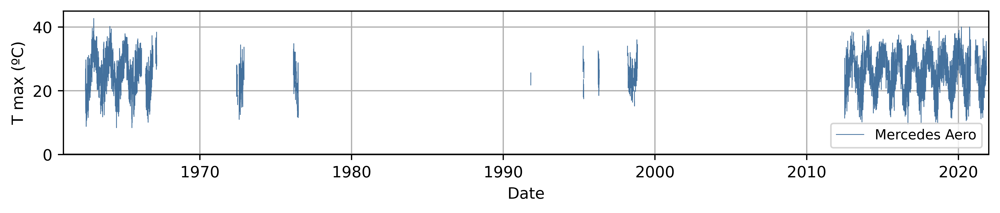

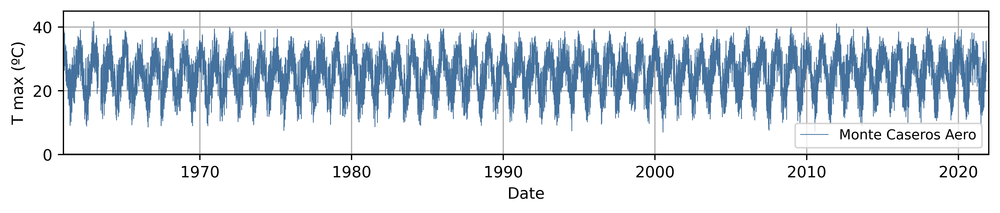

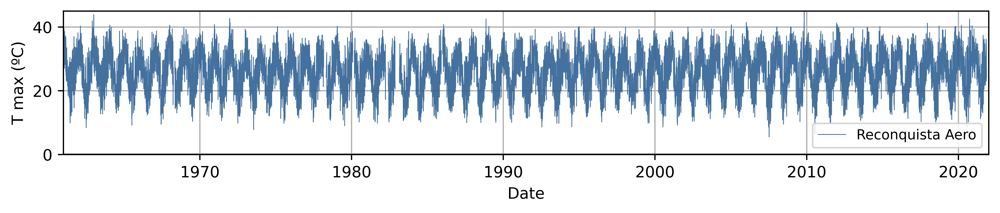

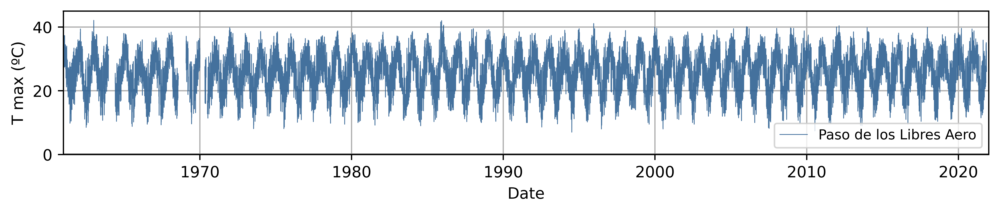

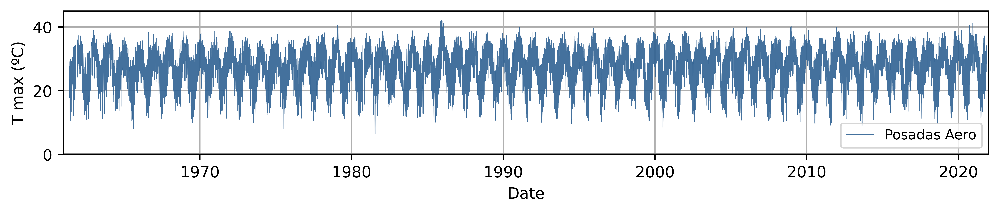

...

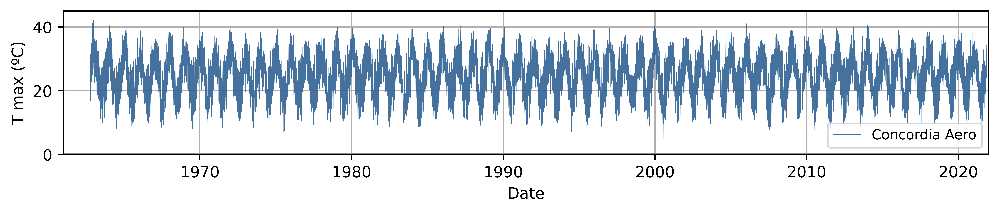

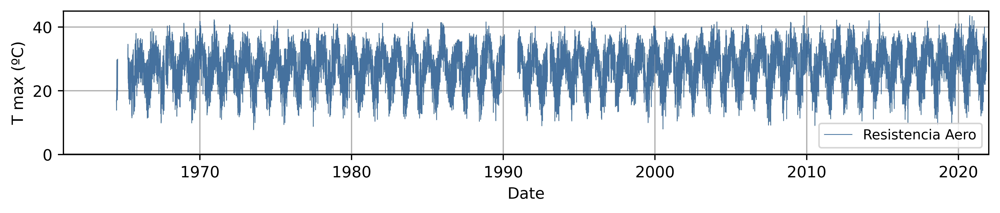

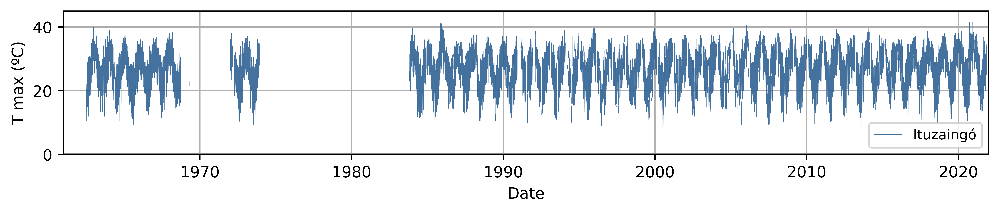

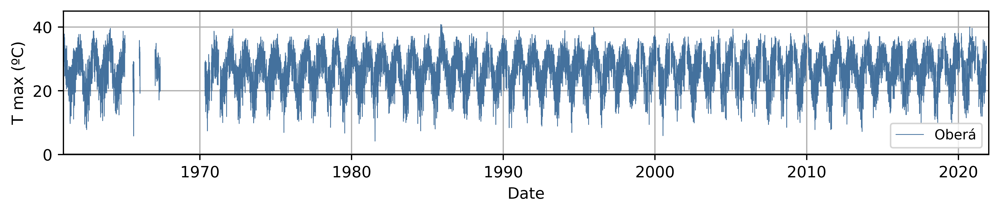

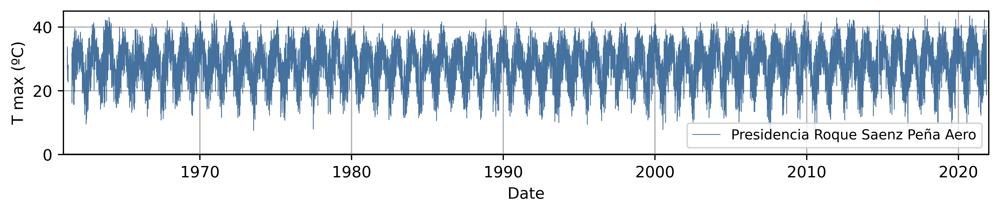

In [3]:
############# 1. GRAFICO SERIES DIARIAS PARA VER DONDE ESTAN LOS DATOS FALTANTES #############
import matplotlib.pyplot as plt

#figura
def f_plot_control_calidad(num):
    fig = plt.figure(num=1, figsize=(9, 2), dpi=900) #(9, 2)
    plt.subplot(1, 1, 1)
    plt.plot(datos_smn[tabla_info_estaciones["Code"][num]], color = "#306292", linewidth = 0.5, alpha = 0.9)
    ylim = 45
    plt.ylim((0,ylim))
    plt.ylabel("T max (ºC)")
    plt.xlim((dt.datetime(year=1961,month=1, day=1),dt.datetime(year=2022,month=1, day=1)))
    plt.xlabel("Date")  
    plt.axhline(y=0, color='grey', linestyle='-')
    plt.legend([tabla_info_estaciones["Name"][num]], loc ="lower right", ncol=2, prop={'size': 8.8})
    plt.grid()
    plt.tight_layout()
    return(fig)

for num in range(0,11):
    f_plot_control_calidad(num)
    plt.show()

In [ ]:
#veo valores imposibles

In [ ]:
#1.a veo que Tmin < Tmax 

#Abro datos de Tmin Tmax PP nub juntas porque lo voy a usar para analizar outliers
from f_abrir_datos_smn import abrir_datos_smn
nombres_archivos = os.listdir(ruta_a_archivos_smn)
datos_smn_extendidos = {}
for nombre_archivo in nombres_archivos:
    id_data = abrir_datos_smn(ruta_a_archivos = ruta_a_archivos_smn, nombre_archivo = nombre_archivo, 
                              variable = ["tmin", "tmax", "prcp", "nub"])
    datos_smn_extendidos[id_data[0]] = id_data[1]

for ide in tabla_info_estaciones["Code"]:
    casos_imp = sum(datos_smn_extendidos[87187]["tmax"] < datos_smn_extendidos[87187]["tmin"]) #cantidad de valores que verifican esto
    print(f"Estacion: {ide} , Tmin>Tmax {casos_imp} veces")

#esto no se da nunca

In [9]:
#1.b. considerando los extremos registrados por el SMN

#Valor de tmax más baja y tmax mas alta:

#mercedes aero 87281
mercedes_min = {1: 21.6, 2: 21.8, 3: 19.1, 4: 15.5, 5: 13, 6: 11.2, 7: 8.4, 8: 10, 9: 9.4, 10: 13.8, 11: 19, 12: 20.4} #mes: valor 
mercedes_max = {1: 42.7, 2: 42.5, 3: 40, 4: 34.6, 5: 32, 6: 32, 7: 31.8, 8: 36.4, 9: 40, 10: 38, 11: 39.6, 12: 40} #mes: valor 

#montecaseros 87393
montecaseros_min = {1: 21.6, 2: 19, 3: 16.8, 4: 12.6, 5: 10, 6: 8, 7: 7, 8: 8.6, 9: 10, 10: 13.2, 11: 16.6, 12:20.3 } #mes: valor 
montecaseros_max = {1: 41.7, 2: 42.1, 3: 40.3, 4: 39.1, 5: 33.7, 6: 30.9, 7: 31.6, 8: 35.8, 9: 37, 10: 38.3, 11: 39.8, 12:41 } #mes: valor 

#reconquista 87270
reconquista_min = {1: 20.8, 2:18.9 , 3:15.6 , 4:13.7 , 5:10.6 , 6:9.1 , 7:5.5 , 8:9.6 , 9:9.8 , 10:12.5 , 11:17 , 12:17.5 } #mes: valor 
reconquista_max = {1: 43.9, 2:42.3 , 3:40.5 , 4:37 , 5:34.8 , 6:32.2 , 7:34.2 , 8:38.4 , 9:42.5 , 10:41.2 , 11:45.2 , 12:42.7 } #mes: valor 

#paso de los libres 87289
pasodeloslibres_min = {1: 21.4, 2:19 , 3:17.6 , 4:12.3 , 5:10.7 , 6:8 , 7:7 , 8:9 , 9:9.5 , 10:14.4 , 11:15.8 , 12:20.5 } #mes: valor 
pasodeloslibres_max = {1: 42.5, 2:41.8 , 3:39.6 , 4:36.7 , 5:34.4 , 6:31.5 , 7:31.4 , 8:35.9 , 9:36.4 , 10:38.3 , 11:41.6 , 12:42 } #mes: valor 

#posadas 87178
posadas_min = {1:22.2 , 2:19.2 , 3:18.3 , 4:16 , 5:11 , 6:10.3 , 7:6.3 , 8:8.1 , 9:10.7 , 10:11.4 , 11:15.8 , 12:21.2 } #mes: valor 
posadas_max = {1:42.5 , 2:40.7 , 3:39.5 , 4:36.2 , 5:34.8 , 6:31.2 , 7:33 , 8:38.2 , 9:39.3 , 10:40.6 , 11:41.7 , 12:42.1 } #mes: valor 

#corrientes 87166
corrientes_min = {1:22.5 , 2:20.9 , 3:16.9 , 4:16.2 , 5:10.4 , 6:9.1 , 7:7.7 , 8:9.4 , 9:10.5 , 10:14.8 , 11:18 , 12:19.6 } #mes: valor 
corrientes_max = {1:42.6 , 2:42.8 , 3:40.6 , 4:37.2 , 5:34.6 , 6:34.1 , 7:33 , 8:37.9 , 9:43.3 , 10:43.5 , 11:42.4 , 12:41.1 } #mes: valor 

#concordia 87395
concordia_min = {1:21.3 , 2:19.2 , 3:15.4 , 4:12.5 , 5:10 , 6:7.2 , 7:5.3 , 8:8 , 9:9.4 , 10:11.8 , 11:15.2 , 12:17.4 } #mes: valor 
concordia_max = {1:42.1 , 2:40.6 , 3:38.7 , 4:35.8 , 5:32.5 , 6:30.4 , 7:32 , 8:35.6 , 9:37.2 , 10:37.4 , 11:38.7 , 12:40.7 } #mes: valor 

#resistencia 87155
resistencia_min = {1:22.8 , 2:20.8 , 3:16.6 , 4:15.7 , 5:10.5 , 6:8.8 , 7:7.8 , 8:9.2 , 9:10 , 10:14.4 , 11:17.8 , 12:19 } #mes: valor 
resistencia_max = {1:43.7 , 2:43.5 , 3:41 , 4:38.1 , 5:35.5 , 6:34.1 , 7:35.5 , 8:38 , 9:43.5 , 10:44.4 , 11:43.5 , 12:42.3 } #mes: valor 

#ituzaingo 87173
ituzaingo_min = {1:22.5 , 2:23 , 3:20 , 4:15 , 5:11.7 , 6:9 , 7:8 , 8:8.5 , 9:9.5 , 10:15 , 11:18 , 12:21 } #mes: valor 
ituzaingo_max = {1:43 , 2:41.5 , 3:39.5, 4:36 , 5:34 , 6:30.8 , 7:37.3 , 8:36.8 , 9:38.7 , 10:41.4 , 11:41.7 , 12:41 } #mes: valor 

#obera 87187
obera_min = {1:19.2 , 2:20.4 , 3:19 , 4:14.5 , 5:8.4 , 6:8.4 , 7:4.2 , 8:5.8 , 9:8.5 , 10:11.9 , 11:15.7 , 12:19.4 } #mes: valor 
obera_max = {1:39.5 , 2:39.6 , 3:39.4 , 4:36.4 , 5:33.1 , 6:30 , 7:32.5 , 8:36 , 9:38.5 , 10:40 , 11:40.8 , 12:40.7 } #mes: valor 

#roque saenz peña 87148
roquesaenz_min = {1:19.8 , 2:19.6 , 3:16.2 , 4:13 , 5:10.4 , 6:8 , 7:6.4 , 8:8 , 9:8.7 , 10:14.2 , 11:16.8 , 12:17.6 } #mes: valor 
roquesaenz_max = {1:43 , 2:42.2 , 3:40.6 , 4:37 , 5:36.6 , 6:33.6 , 7:36.6 , 8:40 , 9:43.5 , 10:46.1 , 11:44 , 12:44.2 } #mes: valor 

#tabla_info_estaciones["Code"]
maximas_mas_bajas_smn = {87281: mercedes_min,
                        87393: montecaseros_min,
                        87270: reconquista_min,
                        87289: pasodeloslibres_min,
                        87178: posadas_min,
                        87166: corrientes_min,
                        87395: concordia_min,
                        87155: resistencia_min,
                        87173: ituzaingo_min,
                        87187: obera_min,
                        87148: roquesaenz_min}

maximas_mas_altas_smn = {87281: mercedes_max,
                        87393: montecaseros_max,
                        87270: reconquista_max,
                        87289: pasodeloslibres_max,
                        87178: posadas_max,
                        87166: corrientes_max,
                        87395: concordia_max,
                        87155: resistencia_max,
                        87173: ituzaingo_max,
                        87187: obera_max,
                        87148: roquesaenz_max}

#para acceder a elemento minimas_mas_bajas_smn[codigo][mes]

In [10]:
#imprimo los que verifican que son mayores del valor minimo mas alto registrado por el smn
for ide in tabla_info_estaciones["Code"]:
    imposible_mayores_x_mes = dict()
    for mes in range(1,13):
        serie_mes = datos_smn[ide][datos_smn[ide].index.month == mes]
        valor_mes = maximas_mas_altas_smn[ide][mes]
        verifican = serie_mes["tmax"][serie_mes["tmax"] > valor_mes]
        if len(verifican)>0:
            print(ide)
            print(verifican)
        
#no se verifica en ningun caso


87395
fecha
1962-11-28    41.2
Name: tmax, dtype: float64


In [11]:
#imprimo los que verifican que son menores del valor minimo mas bajo registrado por el smn
for ide in tabla_info_estaciones["Code"]:
    for mes in range(1,13):
        serie_mes = datos_smn[ide][datos_smn[ide].index.month == mes]
        valor_mes = maximas_mas_bajas_smn[ide][mes]
        verifican = serie_mes["tmax"][serie_mes["tmax"] < valor_mes]
        if len(verifican)>0:
            print(ide)
            print(verifican)
        
#no se verifica en ningun caso

In [12]:
############# 2. VEO OUTLIERS CONSIDERANDO TENDENCIA DE SERIES #############
#primero filtro la serie original con la tendencia de theil-sen
#defino funcion que calcula tendencia_theil_sen
import pymannkendall as mk
import scipy
import numpy as np

variable = "tmax"

#filtro tendencia theil sen 
def filtro_tendencia_theil_sen(ide, serie, variable = "tmax"):
    valores = serie.values[np.isfinite(serie.values)]
    #fechas = np.arange(0, len(serie), 1)[np.isfinite(serie.values)]
    fechas = np.arange(0, len(valores), 1)
        
    # si el vector es todo de nan entonces que no calcule la tendencia, y que devuelva nan
    if valores.size <= 1:
        tendencia = np.nan
        significativo = np.nan
        serie_filtrada = serie
    
    # si el vector tiene valores distintos de nan calcula tendencia y significancia con 95%
    elif valores.size > 1:
        coef = scipy.stats.mstats.theilslopes(y=valores, x=fechas, alpha=0.95)
        tendencia = coef[0]  # dada entre un intervalo de tiempo. A esta salida si quiero tendencia decadal e ingrese datos de toda la serie mensual lo multiplico por 10*12 y si quiero por decada y vienen dados por un dato anual se multiplica por 10
        coord_origen = coef[1]
        #tendencia_smn_sen = coord_origen + tendencia * np.arange(0, len(serie.index), 1)
        tendencia_smn_sen = tendencia * np.arange(0, len(serie.index), 1) #solo la pendiente
        
        ##Hago el test con el p-value para y determino si es significativo con 90% de confianza
        pvalue_test = mk.original_test(valores)[2]
        if pvalue_test <= 0.1: #si es significativo con 90% de confianza, la filtro
            tendencia_smn_sen_df = pd.DataFrame(tendencia_smn_sen)
            tendencia_smn_sen_df.index = serie.index
            serie_filtrada = serie[variable] - tendencia_smn_sen_df[0] 
            print(f"{ide} se filtra tendencia significativa (tendencia: {tendencia} pvalor: {pvalue_test})") 
        else:
            serie_filtrada = serie #no le estoy sacando la media
            print(f"{ide} no habia tendencia significativa (tendencia: {tendencia} pvalor: {pvalue_test})")   
    #plt.plot(tendencia_smn_sen_df)
    return(serie_filtrada)
#limpiar serie_filtrada antes de correr otra estacion.

#filtro tendencia de theil sen
series_filtradas = dict()
for ide in tabla_info_estaciones["Code"]:
    series_filtradas[ide] = filtro_tendencia_theil_sen(ide, datos_smn[ide].copy())

87281 se filtra tendencia significativa (tendencia: 9.074410163339243e-05 pvalor: 0.08721800218695752)
87393 se filtra tendencia significativa (tendencia: 3.782148260211787e-05 pvalor: 2.0294134817078202e-08)
87270 se filtra tendencia significativa (tendencia: 2.868823065337435e-05 pvalor: 2.4615975191544237e-05)
87289 se filtra tendencia significativa (tendencia: 3.393741939862893e-05 pvalor: 8.737264314273574e-07)
87178 se filtra tendencia significativa (tendencia: 4.6114825916532e-05 pvalor: 2.398081733190338e-14)
87166 se filtra tendencia significativa (tendencia: 3.1152647975077955e-05 pvalor: 3.7382503184080207e-06)
87395 no habia tendencia significativa (tendencia: 0.0 pvalor: 0.44056951811657474)
87155 se filtra tendencia significativa (tendencia: 7.037297677691784e-05 pvalor: 0.0)
87173 se filtra tendencia significativa (tendencia: 9.140767824497387e-05 pvalor: 4.205524817280093e-13)
87187 se filtra tendencia significativa (tendencia: 4.020908725371991e-05 pvalor: 3.7517988715

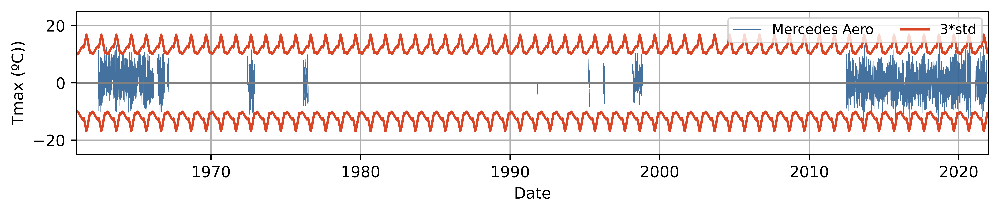

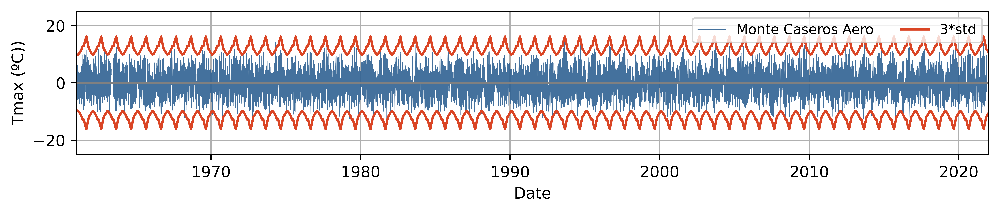

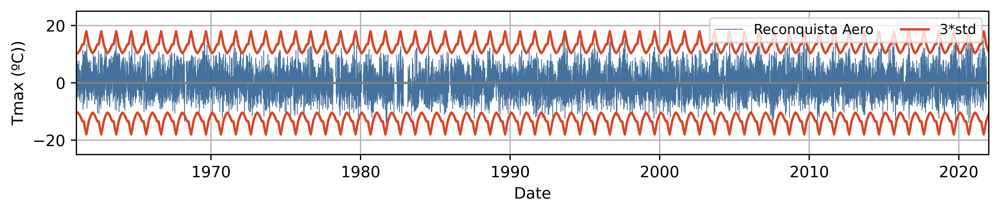

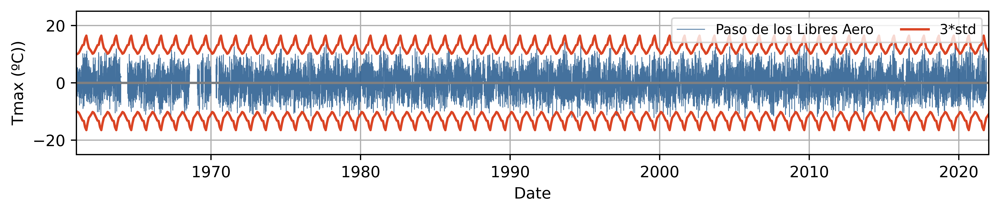

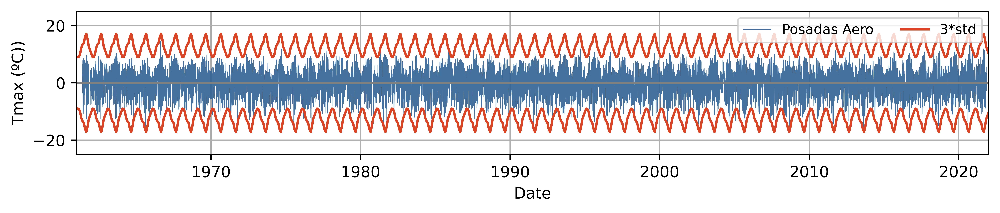

...

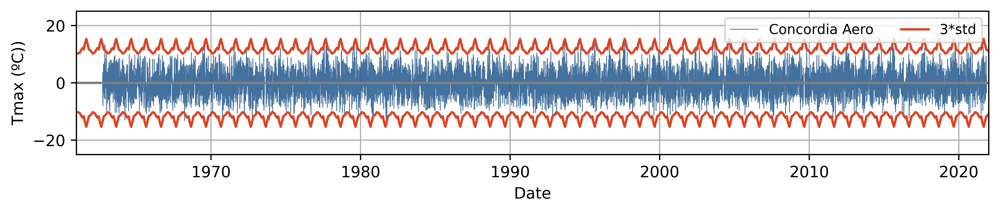

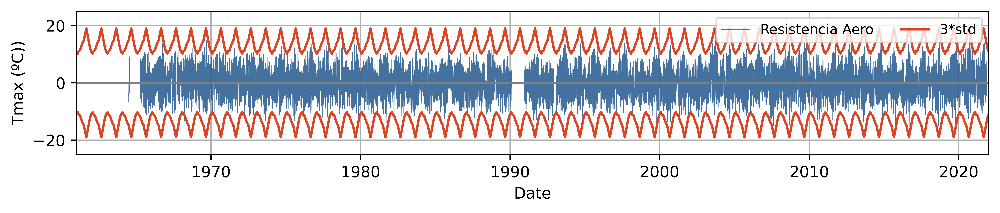

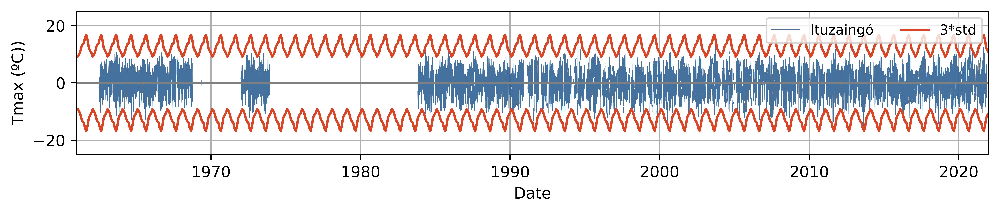

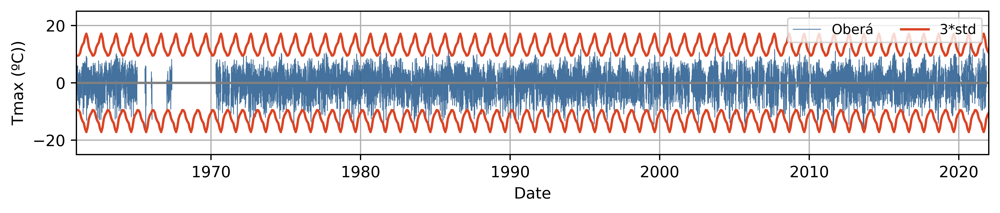

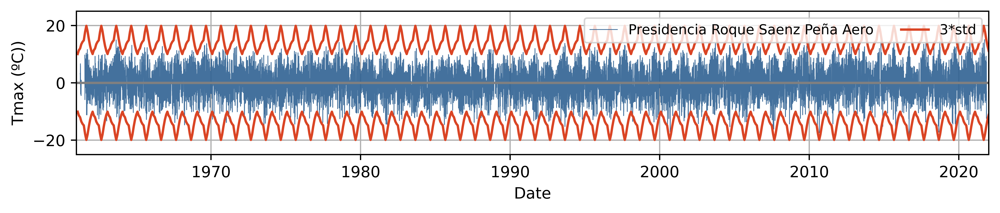

In [14]:
#Grafico series con limites de desvios
import matplotlib.pyplot as plt

#calculo la climatologia de los valores diarios: media y desvio climatologica mensual de los datos diarios
fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"
climatologia_mensual_media_datos_diarios_smn_filtrados = {}
climatologia_mensual_desvio_datos_diarios_smn_filtrados = {}
for id_omm in tabla_info_estaciones["Code"]: #para cada id_omm_ordenado
    diarios_df = series_filtradas[id_omm]
    diarios_df.index = pd.to_datetime(diarios_df.index)
    diarios_fechas_climatologia = diarios_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    diarios_df_climatologia_media = diarios_fechas_climatologia.groupby(diarios_fechas_climatologia.index.month).mean() 
    diarios_df_climatologia_desvio = diarios_fechas_climatologia.groupby(diarios_fechas_climatologia.index.month).std() 
    #Lo guardo en diccionarios
    climatologia_mensual_media_datos_diarios_smn_filtrados[id_omm] = diarios_df_climatologia_media
    climatologia_mensual_desvio_datos_diarios_smn_filtrados[id_omm] = diarios_df_climatologia_desvio

#estimo valor-media
#veo si es mayor a 3*desvio o menor a -3*desvio
series_diario_anom_filtrados = {}
for num in range(0,11):
    cod = tabla_info_estaciones["Code"][num]
    serie_diario = series_filtradas[cod]
    serie_diario_anom = serie_diario.copy()
    for mes in range(1,13):
        serie_diario_anom[serie_diario_anom.index.month == mes] = serie_diario[serie_diario.index.month == mes] - float(climatologia_mensual_media_datos_diarios_smn_filtrados[cod].loc[mes])
    series_diario_anom_filtrados[cod] = serie_diario_anom

#genero serie de + tres veces el desvio y - tres veces el desvio
#fechas_1961_2020_mensual = dt.datetime(year=1961,month=1, day=1),dt.datetime(year=2022,month=1, day=1))    
fechas_1961_2020_mensual = pd.date_range(start="1961-01",end="2022-01", freq = "M")
cant_anios = int(len(fechas_1961_2020_mensual)/12)
series_desvios_mens = {}
for num in range(0,11):
    cod = tabla_info_estaciones["Code"][num]
    desvios = pd.concat([climatologia_mensual_desvio_datos_diarios_smn_filtrados[cod]]*cant_anios)
    desvios.index = fechas_1961_2020_mensual
    series_desvios_mens[cod] = desvios
    
def f_plot_control_calidad_3(num, series_filtradas = series_diario_anom_filtrados, series_desvios_mens = series_desvios_mens):
    fig = plt.figure(num=1, figsize=(9, 2), dpi=900)
    plt.subplot(1, 1, 1)
    plt.plot(series_filtradas[tabla_info_estaciones["Code"][num]], color = "#306292", linewidth = 0.5, alpha = 0.9)
    plt.plot(3*series_desvios_mens[tabla_info_estaciones["Code"][num]], color = "#DA4525")
    plt.plot(-3*series_desvios_mens[tabla_info_estaciones["Code"][num]], color = "#DA4525")
    ylim = 25
    plt.ylim((-ylim,ylim))
    plt.ylabel("Tmax (ºC))")
    plt.xlim((dt.datetime(year=1961, month=1, day=1),dt.datetime(year=2022,month=1, day=1)))
    plt.xlabel("Date")  
    plt.axhline(y=0, color='grey', linestyle='-')
    plt.legend([tabla_info_estaciones["Name"][num],"3*std"], loc ="upper right", ncol=2, prop={'size': 8.8})
    plt.grid()
    plt.tight_layout()
    return(fig)


for num in range(0,11):
    f_plot_control_calidad_3(num)
    plt.show()
    

In [15]:
#Abro datos de Tmin Tmax PP nub juntas porque lo voy a usar para analizar outliers
from f_abrir_datos_smn import abrir_datos_smn
nombres_archivos = os.listdir(ruta_a_archivos_smn)
datos_smn_extendidos = {}
for nombre_archivo in nombres_archivos:
    id_data = abrir_datos_smn(ruta_a_archivos = ruta_a_archivos_smn, nombre_archivo = nombre_archivo, 
                              variable = ["tmin", "tmax", "prcp", "nub"])
    datos_smn_extendidos[id_data[0]] = id_data[1]

In [52]:
##Identifico un outlier en cada estacion
ide = 87148
serie_anom_diario = series_diario_anom_filtrados[ide]
variable = "tmax"

##si le resto tres veces el desvio queda mayor a 0? --> outlier positivo
outliers_pos_x_mes = dict()
for mes in range(1,13):
    outliers_pos_x_mes[mes] = serie_anom_diario[serie_anom_diario.index.month == mes] - 3 * float(np.unique(series_desvios_mens[ide][series_desvios_mens[ide].index.month == mes]))
outliers_pos = pd.concat(outliers_pos_x_mes)
outliers_pos.index = outliers_pos.index.droplevel(-2)
outliers_pos = outliers_pos.sort_index()
#fechas_outliers_pos = outliers_pos[(outliers_pos[outliers_pos > 0].isnull() == False)]
fechas_outliers_pos = (outliers_pos[outliers_pos > 0].isnull() == False).index
#fechas_outliers_pos = outliers_pos[(outliers_pos["tmax"] > 0) == True].index #para estacion 87148 y 395

#outliers_positivos = serie_anom_diario.loc[fechas_outliers_pos.index]
outliers_positivos = serie_anom_diario.loc[fechas_outliers_pos]

##si le sumo tres veces el desvio queda menor a 0? --> outlier negativo
outliers_neg_x_mes = dict()
for mes in range(1,13):
    outliers_neg_x_mes[mes] = serie_anom_diario[serie_anom_diario.index.month == mes] + 3 * float(np.unique(series_desvios_mens[ide][series_desvios_mens[ide].index.month == mes]))
outliers_neg = pd.concat(outliers_neg_x_mes)
outliers_neg.index = outliers_neg.index.droplevel(-2)
outliers_neg = outliers_neg.sort_index()
#fechas_outliers_neg = outliers_neg[(outliers_neg[outliers_neg <0].isnull() == False)[variable]]
fechas_outliers_neg = (outliers_neg[outliers_neg <0].isnull() == False).index
#fechas_outliers_neg = outliers_neg[(outliers_neg["tmax"] < 0) == True].index #para estacion 87148 y 395

#outliers_negativos = serie_anom_diario.loc[fechas_outliers_neg.index]
outliers_negativos = serie_anom_diario.loc[fechas_outliers_neg]

In [53]:
print(len(outliers_positivos))
print(len(outliers_negativos))

3
23


In [54]:
outliers_positivos.index

DatetimeIndex(['1970-12-10', '2009-11-02', '2014-10-16'], dtype='datetime64[ns]', name='fecha', freq=None)

In [55]:
outliers_negativos.index

DatetimeIndex(['1963-01-11', '1963-11-08', '1968-03-26', '1970-02-06',
               '1971-01-11', '1971-03-15', '1972-03-26', '1977-03-31',
               '1988-01-22', '1989-04-29', '1998-01-30', '1998-03-12',
               '2001-04-30', '2001-11-25', '2001-12-01', '2002-01-21',
               '2003-02-21', '2008-01-23', '2012-12-27', '2014-12-01',
               '2015-10-10', '2016-09-03', '2019-10-15'],
              dtype='datetime64[ns]', name='fecha', freq=None)

In [18]:
#outliers positivos
#veo dos dias siguientes y dos anteriores y veo tambien la tmax, tmin, precip y nubosidad
for i in range(0, len(outliers_positivos)):
    pos_fecha = i
    fechas_entorno_outlier = pd.date_range(outliers_positivos.index[pos_fecha]-dt.timedelta(days = 2), outliers_positivos.index[pos_fecha]+dt.timedelta(days = 2)) 
    print(datos_smn_extendidos[ide].loc[fechas_entorno_outlier])

            tmax  tmin  prcp  nub
fecha                            
1962-11-26  37.9  21.0   0.0  4.0
1962-11-27  37.7  21.1   0.0  2.0
1962-11-28  39.8  24.2  35.8  1.0
1962-11-29  32.9  17.5  22.0  5.0
1962-11-30  28.7  15.8   0.0  1.0
            tmax  tmin  prcp  nub
fecha                            
1974-04-15  29.8  14.4   0.0  2.0
1974-04-16  32.9  17.0   0.0  1.0
1974-04-17  39.1  19.4   7.1  2.0
1974-04-18  26.7  14.5  27.2  8.0
1974-04-19  20.1   9.5   0.0  1.0
            tmax  tmin  prcp  nub
fecha                            
2013-09-10  36.6  19.2   0.0  1.0
2013-09-11  36.4  19.3   0.0  0.0
2013-09-12  37.0  19.4   0.0  2.0
2013-09-13  29.0  15.3  33.0  7.0
2013-09-14  15.4  12.0  34.0  8.0
            tmax  tmin  prcp  nub
fecha                            
2019-10-10  33.3  18.1   0.0  4.0
2019-10-11  37.5  21.3   0.0  2.0
2019-10-12  38.3  24.4   0.0  2.0
2019-10-13  31.4  20.0  19.0  5.0
2019-10-14  20.0  10.0  13.0  8.0


In [24]:
#outliers negativos
#veo dos dias siguientes y dos anteriores y veo tambien la tmax, tmin, precip y nubosidad
for i in range(0, len(outliers_negativos)):
    pos_fecha = i
    fechas_entorno_outlier = pd.date_range(outliers_negativos.index[pos_fecha]-dt.timedelta(days = 2), outliers_negativos.index[pos_fecha]+dt.timedelta(days = 2)) 
    print(datos_smn_extendidos[ide].loc[fechas_entorno_outlier])

            tmax  tmin  prcp  nub
fecha                            
1963-01-09  39.2  24.2   0.0  7.0
1963-01-10  30.4  20.3  12.0  8.0
1963-01-11  20.3  16.8   0.2  8.0
1963-01-12  29.8  19.5   0.0  6.0
1963-01-13  33.8  21.8   0.0  5.0
            tmax  tmin  prcp  nub
fecha                            
1963-11-06  23.8  21.2  11.9  8.0
1963-11-07  24.8  16.8   7.3  8.0
1963-11-08  16.8  13.0   0.3  8.0
1963-11-09  22.8  12.6   0.0  4.0
1963-11-10  28.9  10.4   0.0  0.0
            tmax  tmin  prcp  nub
fecha                            
1968-03-24  35.6  24.2   0.0  0.0
1968-03-25  28.6  14.6  14.4  7.0
1968-03-26  16.2  12.8   0.4  7.0
1968-03-27  23.4   8.2   0.0  2.0
1968-03-28  24.3  11.5   0.0  7.0
            tmax  tmin  prcp  nub
fecha                            
1970-02-04  38.1  23.6   0.0  1.0
1970-02-05  38.0  18.4  64.4  5.0
1970-02-06  19.8  14.6   3.3  8.0
1970-02-07  22.6  15.3   0.0  6.0
1970-02-08  28.8  11.7   0.0  1.0
            tmax  tmin  prcp  nub
fecha         

In [4]:
import numpy as np

In [5]:
#Elimino outliers que no tienen consistencia fisica de las series

#reconquista
datos_smn[87270][datos_smn[87270].index == "2020-09-26"] = np.nan
datos_smn[87270][datos_smn[87270].index == "2020-09-30"] = np.nan

#paso de los libres

#posadas

#concordia
datos_smn[87395][datos_smn[87395].index == "1962-11-28"] = np.nan

#resistencia 155

#obera 187
datos_smn[87187][datos_smn[87187].index == "1972-12-25"] = np.nan
datos_smn[87187][datos_smn[87187].index == "1990-05-22"] = np.nan

#roque saenz peña 148
datos_smn[87148][datos_smn[87148].index == "2002-01-21"] = np.nan
datos_smn[87148][datos_smn[87148].index == "2008-01-23"] = np.nan


In [6]:
#guardo series de Tmin con control de calidad
datos_smn_df = pd.concat(datos_smn, axis = 1)
datos_smn_df.columns  = [datos_smn_df.columns[i][0] for i in range(0,len(list(datos_smn_df.columns)))]

#los guardo
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE Tmax_curados_diarios_SMN.csv")
datos_smn_df.to_csv("Tmax_curados_diarios_SMN.csv")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/codigos/codigos2023") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))


CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2023/temperatura_maxima


SAVE Tmax_curados_diarios_SMN.csv


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2023


## Hago climatologia

In [7]:
############# SERIES MENSUALES #############

#calculo series de medias mensuales de cada estacion
#los meses con mas de 20% de datos faltantes se computan como NA
from f_media_mensual_smn import f_media_mensual_smn 
porcentaje_na_admitido = 20
medias_mensuales_smn = {} #genero diccionario donde se van a guardar las medias mensuales
for id_omm in tabla_info_estaciones["Code"]:
    media_mensual_df = f_media_mensual_smn(id_omm, datos_smn[id_omm], porcentaje_na_admitido, "tmax") #uso funcion f_media_mensual_smn en f_paper_nubosidad_NEA
    medias_mensuales_smn[id_omm] = media_mensual_df

In [8]:
#guardo series mensuales
medias_mensuales_smn_df = pd.concat(medias_mensuales_smn, axis = 1)
medias_mensuales_smn_df.columns  = [medias_mensuales_smn_df.columns[i][0] for i in range(0,len(list(datos_smn_df.columns)))]

#los guardo
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
print("\n")

print("SAVE Tmax_media_mensual_SMN.csv")
datos_smn_df.to_csv("Tmax_media_mensual_SMN.csv")

print("\n")
#vuelvo a ruta principal
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/codigos/codigos2023") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))


CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2023/temperatura_maxima


SAVE Tmax_media_mensual_SMN.csv


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2023


In [8]:
############# SERIES MENSUALES --> DATOS FALTANTES#############
import datetime as dt

print(f"CREATE TABLE INFO TMAX MENSUAL")
print("\n")

codigos = list(estaciones_smn.EST)
nombres = ["Mercedes Aero", "Monte Caseros Aero", "Reconquista Aero", "Paso de los Libres Aero",
           "Posadas Aero", "Corrientes Aero", "Concordia Aero", "Resistencia Aero", "Ituzaingó", 
           "Oberá", "Presidencia Roque Saenz Peña Aero"]
lons = list(round(estaciones_smn.LON, 3))
lats = list(round(estaciones_smn.LAT,3))
alts = list(estaciones_smn.ALT)
fechas_0 = [str(datos_smn[cod].index[0].month) +"/" + str(datos_smn[cod].index[0].year) for cod in codigos]
fechas_menos1 = [str(datos_smn[cod].index[-1].month) +"/" + str(datos_smn[cod].index[-1].year) for cod in codigos]
porcentajes_faltantes = [round(medias_mensuales_smn[cod].isnull()[0].sum()/len(medias_mensuales_smn[cod][0])*100, 3) for cod in codigos]

#defino fechas climatologicas y para estudios a largo plazo, sale de trabajo con nubosidad
fechas_climatologicas = pd.date_range(start="1983-12",end="2016-12", freq = "M")
fechas_largo_plazo = pd.date_range(start="1961-03",end="2021-03", freq = "M")

porcentajes_faltantes_1983_2016 = [round(medias_mensuales_smn[cod]["1983-12":"2016-11"].isnull()[0].sum()/len(fechas_climatologicas)*100, 3) for cod in codigos]
porcentajes_faltantes_1961_2021 = [round(medias_mensuales_smn[cod]["1961-03":"2021-02"].isnull()[0].sum()/len(fechas_largo_plazo)*100, 3) for cod in codigos]

tabla_info_estaciones_mensuales = pd.DataFrame({"Name": nombres,
                                      "Code": codigos,
                                      "Longitude [º]": lons,
                                      "Latitude [º]": lats,
                                      "Elevation [m]": alts,
                                      "Initial Date [mm/yyyy]":fechas_0,
                                      "Final Date [mm/yyyy]":fechas_menos1,
                                      f"Missing monthly values (Initial-Final Date) [%]": porcentajes_faltantes,
                                      f"Missing monthly values (1983-12-01 - 2016-11-30) [%]": porcentajes_faltantes_1983_2016,
                                      f"Missing monthly values (1961-03-01 - 2021-02-28) [%]": porcentajes_faltantes_1961_2021})


#tabla_info_estaciones_mensuales[["Name", "Missing monthly values (Initial-Final Date) [%]",
#                                "Missing monthly values (1983-12-01 - 2016-11-30) [%]",
#                                "Missing monthly values (1961-03-01 - 2021-02-28) [%]"]]

tabla_info_estaciones_mensuales

CREATE TABLE INFO TMAX MENSUAL




,Name,Code,Longitude [º],Latitude [º],Elevation [m],Initial Date [mm/yyyy],Final Date [mm/yyyy],Missing monthly values (Initial-Final Date) [%],Missing monthly values (1983-12-01 - 2016-11-30) [%],Missing monthly values (1961-03-01 - 2021-02-28) [%]
0,Mercedes Aero,87281,-58.088,-29.222,107,1/1961,11/2021,76.881,86.616,77.778
1,Monte Caseros Aero,87393,57.640,30.271,54,1/1961,11/2021,0.410,0.000,0.417
2,Reconquista Aero,87270,59.693,29.202,53,1/1961,11/2021,1.778,0.253,1.806
3,Paso de los Libres Aero,87289,57.153,29.688,70,1/1961,11/2021,2.873,0.000,2.917
4,Posadas Aero,87178,55.967,27.392,125,1/1961,11/2021,1.231,0.000,0.972
5,Corrientes Aero,87166,58.758,27.449,62,11/1961,11/2021,2.358,0.758,2.361
6,Concordia Aero,87395,58.002,31.303,38,10/1962,11/2021,0.423,0.505,0.417
7,Resistencia Aero,87155,59.049,27.445,52,7/1964,11/2021,3.338,3.283,3.194
8,Ituzaingó,87173,-56.689,-27.589,72,7/1962,11/2021,40.813,32.576,40.417
9,Oberá,87187,55.121,27.487,303,1/1961,11/2021,12.996,7.323,12.917


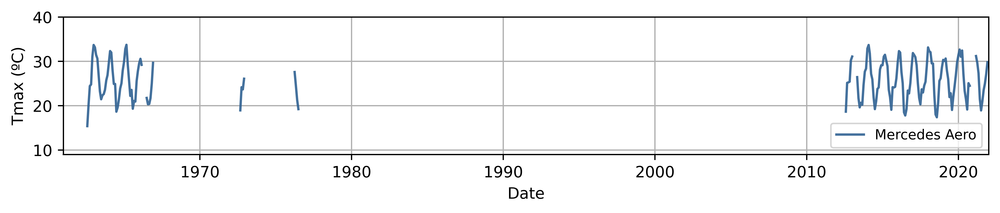

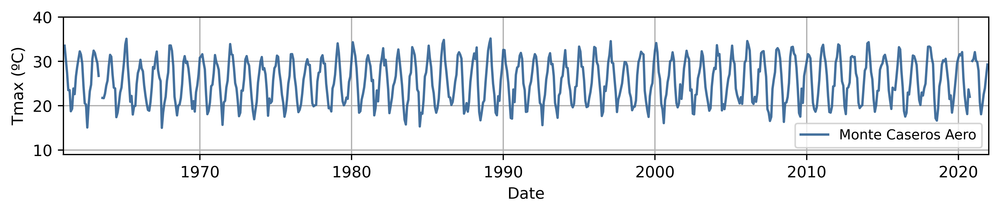

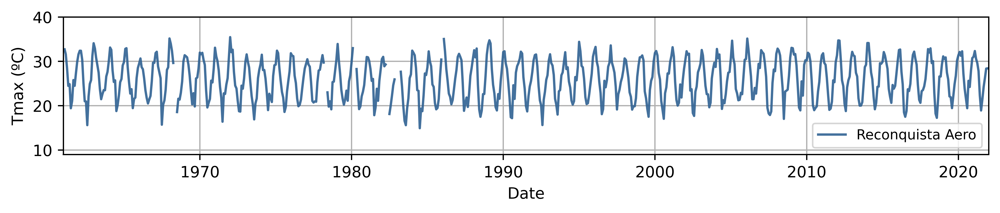

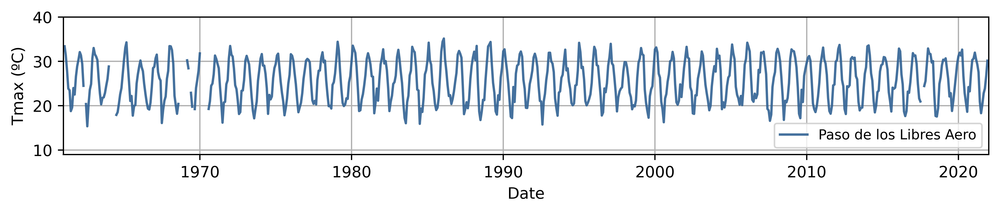

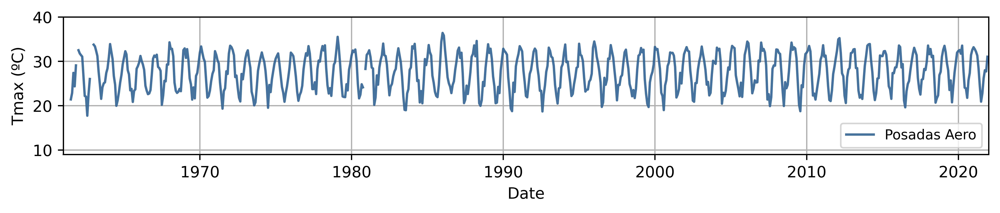

...

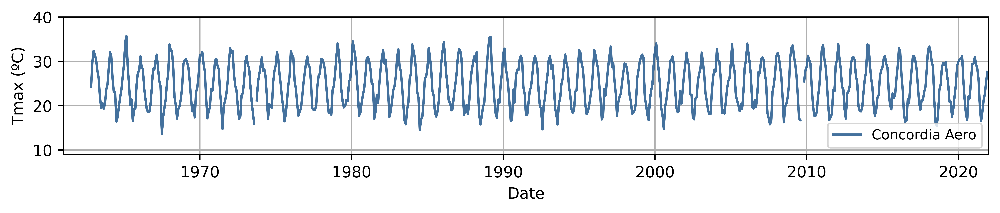

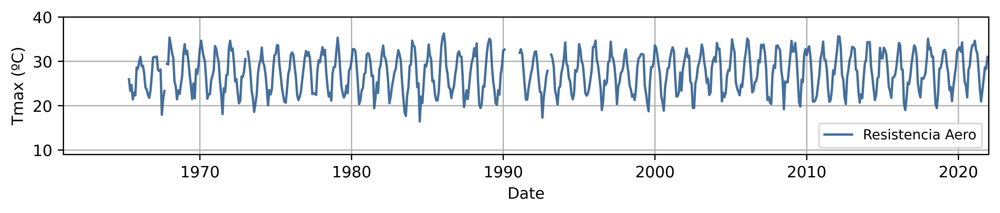

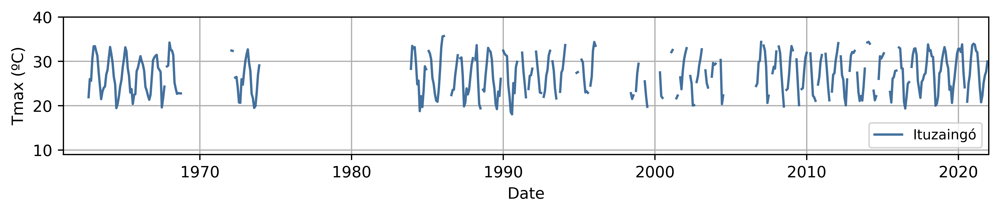

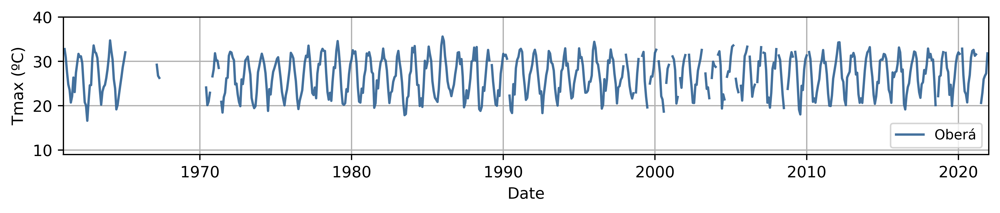

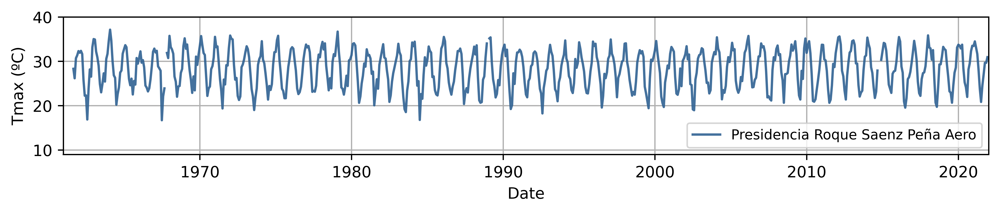

In [10]:
############# SERIES MENSUALES --> GRAFICOS#############

import matplotlib.pyplot as plt

#figura
def f_plot_control_calidad_2(num):
    fig = plt.figure(num=1, figsize=(9, 2), dpi=900)
    plt.subplot(1, 1, 1)
    plt.plot(medias_mensuales_smn[tabla_info_estaciones["Code"][num]], color = "#306292", linewidth = 1.5, alpha = 0.9)
    ylim = 40
    plt.ylim((9,ylim))
    plt.ylabel("Tmax (ºC)")
    plt.xlim((dt.datetime(year=1961,month=1, day=1),dt.datetime(year=2022,month=1, day=1)))
    plt.xlabel("Date")  
    plt.axhline(y=0, color='grey', linestyle='-')
    plt.legend([tabla_info_estaciones["Name"][num]], loc ="lower right", ncol=2, prop={'size': 8.8})
    plt.grid()
    plt.tight_layout()
    return(fig)

for num in range(0,11):
    f_plot_control_calidad_2(num)
    plt.show()    

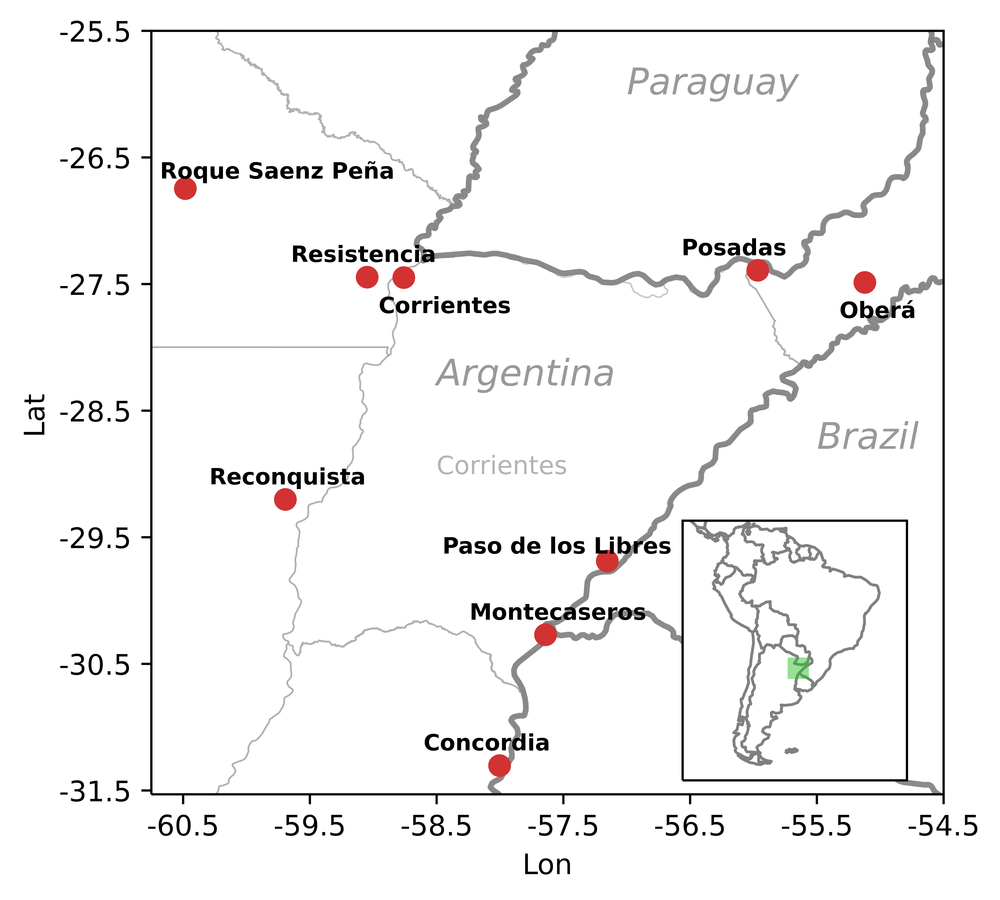

In [11]:
########### 1. MAPA CON ESTACIONES ##########
import warnings
warnings.filterwarnings("ignore") #para que muestre los warnings una sola vez

from f_mis_shapes import df_paises, df_provincias
from f_mapa import f_mapa

lista_puntos_smn = [(360 - lon, -1 * lat) for lon, lat in zip(estaciones_smn["LON"],estaciones_smn["LAT"])]
dict_puntos_smn = dict(zip(list(estaciones_smn["EST"]), lista_puntos_smn))
estaciones_ordenadas = {87148: "Roque Saenz Peña",
                        87155: "Resistencia",
                        87166: "Corrientes",
                        87178: "Posadas",
                        87270: "Reconquista", 
                        87289: "Paso de los Libres", 
                        87393: "Montecaseros", 
                        87395: "Concordia",
                        87187: "Oberá"} #solo me quedo con las que uso, saco Mercedes Aero, Ituzaingó 
ides_omm_ordenado = list(estaciones_ordenadas.keys())
nombres_ides_omm_ordenado = list(estaciones_ordenadas.values())

#cargo shapes
shape_paises = df_paises()
shape_provincias = df_provincias()

#grafico
#print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
#os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
#print("\n")

#print("PLOT AND SAVE IT (use f_mapa in f_paper_nubosidad_NEA)")
f_mapa(dict_puntos_smn, ides_omm_ordenado, nombres_ides_omm_ordenado, shape_paises, shape_provincias)
plt.show()
#print("\n")
#vuelvo a ruta principal
#os.chdir("../../../../../../../../home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
#cwd = os.getcwd()
#print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))

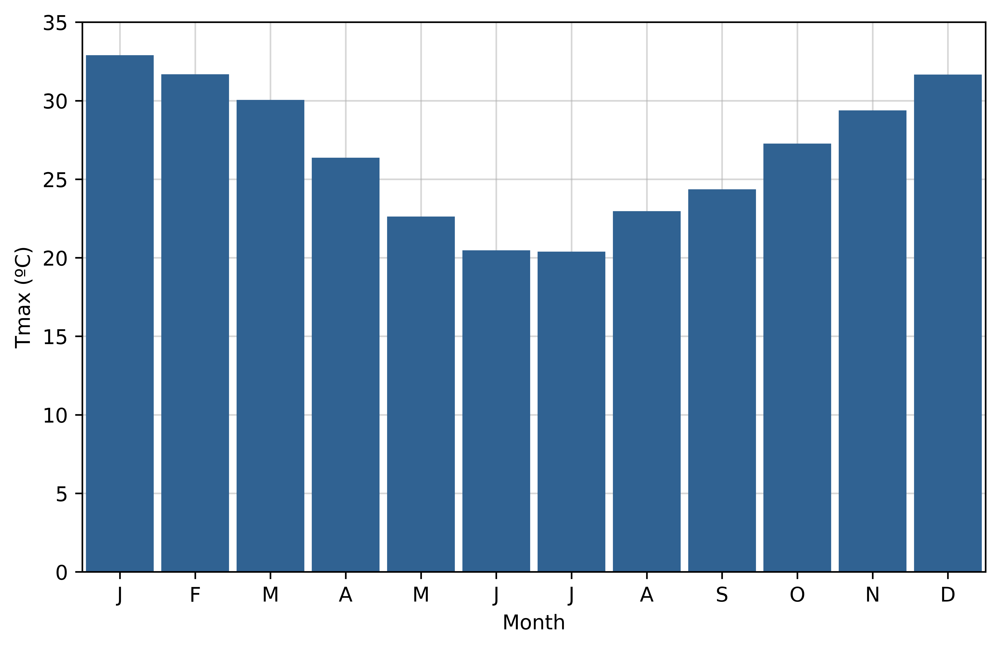

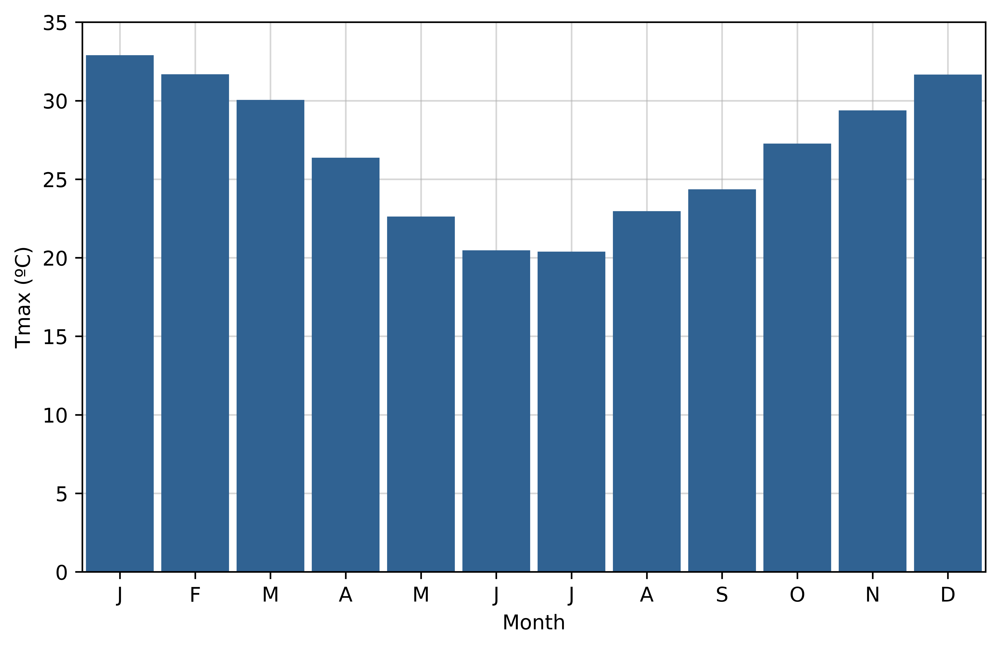

In [14]:
########### 2. CLIMATOLOGIA MEDIA REGIONAL ##########

#media regional
medias_mensuales_smn_media_regional = pd.concat(medias_mensuales_smn, axis = 1).mean(axis=1, skipna=True)

#medias climatologicas
fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"
medias_mensuales_smn_media_regional.index = pd.to_datetime(medias_mensuales_smn_media_regional.index)
medias_mensuales_smn_media_regional_fechas_climatologia = medias_mensuales_smn_media_regional.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
medias_mensuales_smn_media_regional_climatologia = medias_mensuales_smn_media_regional_fechas_climatologia.groupby(medias_mensuales_smn_media_regional_fechas_climatologia.index.month).mean() 

#las grafico
def plot_climatologia_regional():
    fig2 = plt.figure(num=1, figsize=(8, 5), dpi=1000) #genero figura
    ax = fig2.add_subplot(111) # Create matplotlib axes
    meses = ['J', 'F', 'M', 'A', 'M', "J", "J", "A", "S", "O","N", "D"] #inicial meses
    width = 0.9 #ancho de las barras
    medias_mensuales_smn_media_regional_climatologia.plot(kind='bar', color="#306292", ax=ax, width=width, zorder = 2)
    ax.set_ylabel('Tmax (ºC)')
    ax.set_ylim(0, 35)
    plt.xlabel("Month")
    ax.set_xlim(-0.5, 11.5)
    ax.set_xticklabels(meses,rotation = 0)
    ax.grid(alpha = 0.5, zorder = 1)
    return(fig2)

plot_climatologia_regional()

In [15]:
########### 3. MAPA CON MEDIAS ANUALES ##########

# Calculo media anual en periodo climatológico de SMN
climatologia_anual_medias_mensuales_smn = {} 
for id_omm in ides_omm_ordenado:
    #calculo climatologia
    media_mensual_df = medias_mensuales_smn[id_omm]
    media_mensual_df.index = pd.to_datetime(media_mensual_df.index)
    media_mensual_fechas_climatologia = media_mensual_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    media_mensual_climatologia_anual = media_mensual_fechas_climatologia.mean() 
    #Lo guardo en diccionario: climatologia_anual_medias_mensuales_smn
    climatologia_anual_medias_mensuales_smn[id_omm] = media_mensual_climatologia_anual

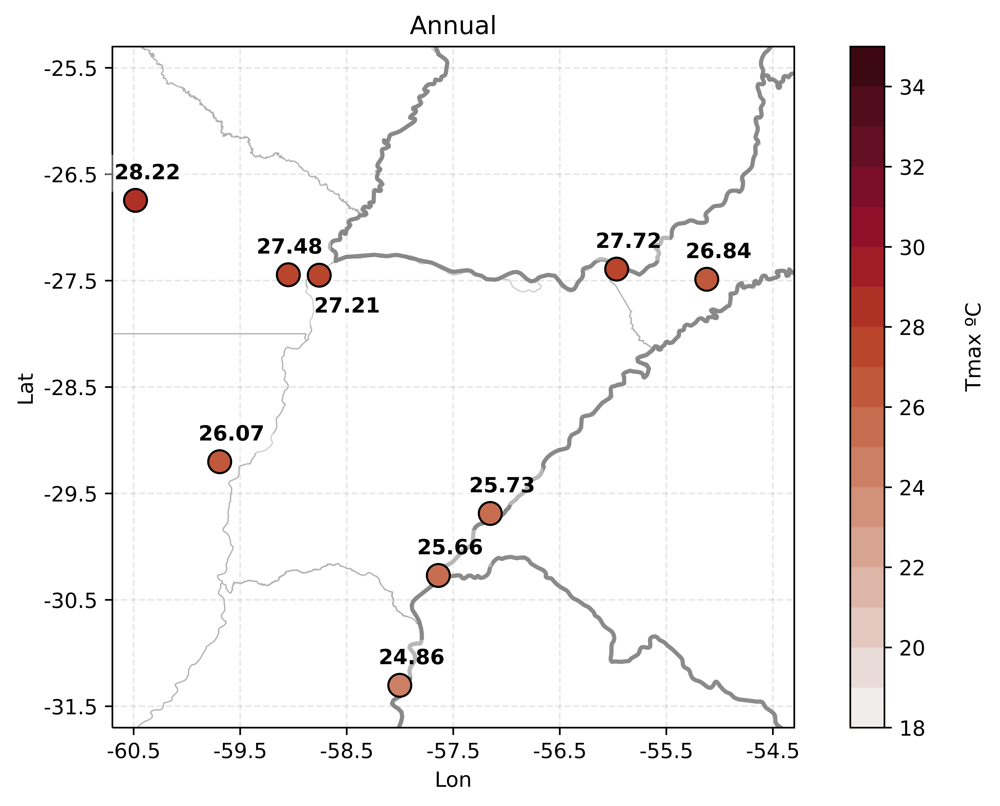

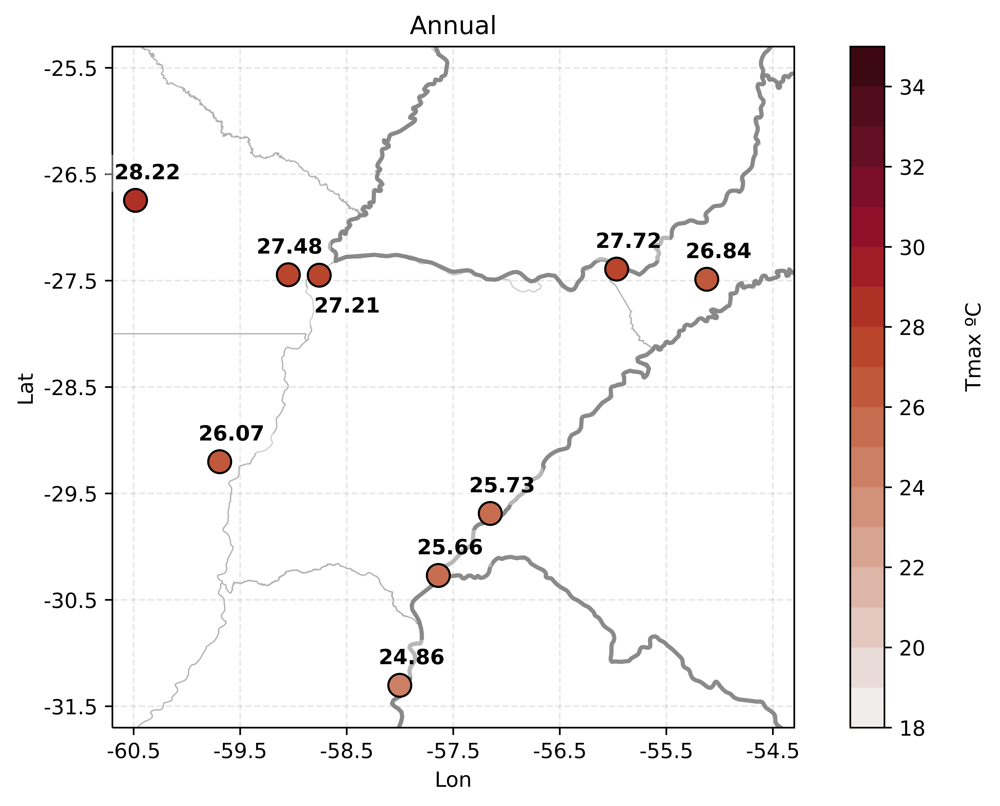

In [26]:
#Grafico
from f_mis_shapes import df_paises, df_provincias
import geopandas as gpd
from shapely.geometry import Point
import cartopy.crs as ccrs
import cmocean 
import matplotlib as mpl

#puntos que uso
lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,9)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)

def plot_mapa_media_anual():
    valor_minimo = 18
    valor_maximo = 35
    xticks_min = -60.5
    xticks_max = -54.5
    yticks_min = -31.5
    yticks_max = -25.5
    espacio_entre_lat_lon = 1
    medias_anuales_estaciones_ordenadas = [climatologia_anual_medias_mensuales_smn[i].values[0] for i in ides_omm_ordenado]

    #defino puntos a marcar
    geometry_3 = [Point(xy) for xy in lista_puntos_smn_ordenados] #lista con puntos 2
    geodata3 = gpd.GeoDataFrame(lista_puntos_smn_ordenados, geometry = geometry_3)
    geodata3["valores"] = medias_anuales_estaciones_ordenadas

    fig3 = plt.figure(figsize = [9.6, 6], dpi = 900)    
    ax = fig3.add_subplot(111, projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

    #agrego geometrias de fondo: provincias y paises
    ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 1)
    ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 2)

    ##esto para discretizar la paleta:
    mi_cmap = cmocean.cm.amp # define the colormap  rain
    mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)] # extract all colors from the .rain map
    mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
        'Custom cmap', mi_cmaplist, mi_cmap.N) # create the new map
    bounds = np.linspace(valor_minimo, valor_maximo, 18) # define the bins and normalize
    norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)

    #ploteo valores
    geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                  markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=True, ax = ax, edgecolor = "k") #limites de 0 a 8

    #agrego etiquetas con valores
    list_smn_etiquetas = [(lon-0.2-360, lat+0.25) for lon, lat in lista_puntos_smn_ordenados]
    for i, clave in enumerate(medias_anuales_estaciones_ordenadas):
        if list(estaciones_ordenadas.values())[i] != "Corrientes" and list(estaciones_ordenadas.values())[i] != "Resistencia":
            t = ax.annotate(str(round(clave,2)), (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        elif list(estaciones_ordenadas.values())[i] == "Corrientes":
            t = ax.annotate(str(round(clave,2)), (list_smn_etiquetas[i][0]+0.15,list_smn_etiquetas[i][1]-0.6) , size = 10,weight='bold', zorder = 3)
        else:
            t = ax.annotate(str(round(clave,2)),(list_smn_etiquetas[i][0]-0.1,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))

    #agrego titulo a colorbar
    trans = ax.get_xaxis_transform() # x in data untis, y in axes fraction
    ann = ax.annotate('Tmax ºC', xy=(-52.7, .5 ), xycoords=trans, rotation = 90)

    #seteo ejes
    ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
    ax.set_xticklabels(np.arange(xticks_min, xticks_max+1))
    plt.xticks(np.arange(xticks_min, xticks_max+1))
    ax.set_xlabel("Lon")
    ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
    ax.set_yticklabels(np.arange(yticks_min, yticks_max+1))
    plt.yticks(np.arange(yticks_min, yticks_max+1))
    ax.set_ylabel("Lat")

    plt.title("Annual")
    plt.grid(linestyle="--", alpha=0.3)
    return(fig3)

plot_mapa_media_anual()

In [18]:
########### 3. MAPA CON MEDIAS ESTACIONALES ##########

# Calculo medias estacionales en periodo climatológico de SMN
climatologia_estacion_medias_mensuales_smn = {} 
#para cada id_omm_ordenado
for id_omm in ides_omm_ordenado:
    #calculo climatologia
    media_mensual_df = medias_mensuales_smn[id_omm]
    media_mensual_df.index = pd.to_datetime(media_mensual_df.index)
    media_mensual_fechas_climatologia = media_mensual_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    media_mensual_climatologia_DJF = (media_mensual_fechas_climatologia[(media_mensual_fechas_climatologia.index.month == 12) | (media_mensual_fechas_climatologia.index.month == 1) | (media_mensual_fechas_climatologia.index.month == 2)]).mean()
    media_mensual_climatologia_MAM = (media_mensual_fechas_climatologia[(media_mensual_fechas_climatologia.index.month == 3) | (media_mensual_fechas_climatologia.index.month == 4) | (media_mensual_fechas_climatologia.index.month == 5)]).mean()
    media_mensual_climatologia_JJA = (media_mensual_fechas_climatologia[(media_mensual_fechas_climatologia.index.month == 6) | (media_mensual_fechas_climatologia.index.month == 7) | (media_mensual_fechas_climatologia.index.month == 8)]).mean()
    media_mensual_climatologia_SON = (media_mensual_fechas_climatologia[(media_mensual_fechas_climatologia.index.month == 9) | (media_mensual_fechas_climatologia.index.month == 10) | (media_mensual_fechas_climatologia.index.month == 11)]).mean()
    media_mensual_climatologia_estacional = {"DJF": media_mensual_climatologia_DJF, "MAM":media_mensual_climatologia_MAM, "JJA":media_mensual_climatologia_JJA, "SON":media_mensual_climatologia_SON}
    climatologia_estacion_medias_mensuales_smn[id_omm] = media_mensual_climatologia_estacional


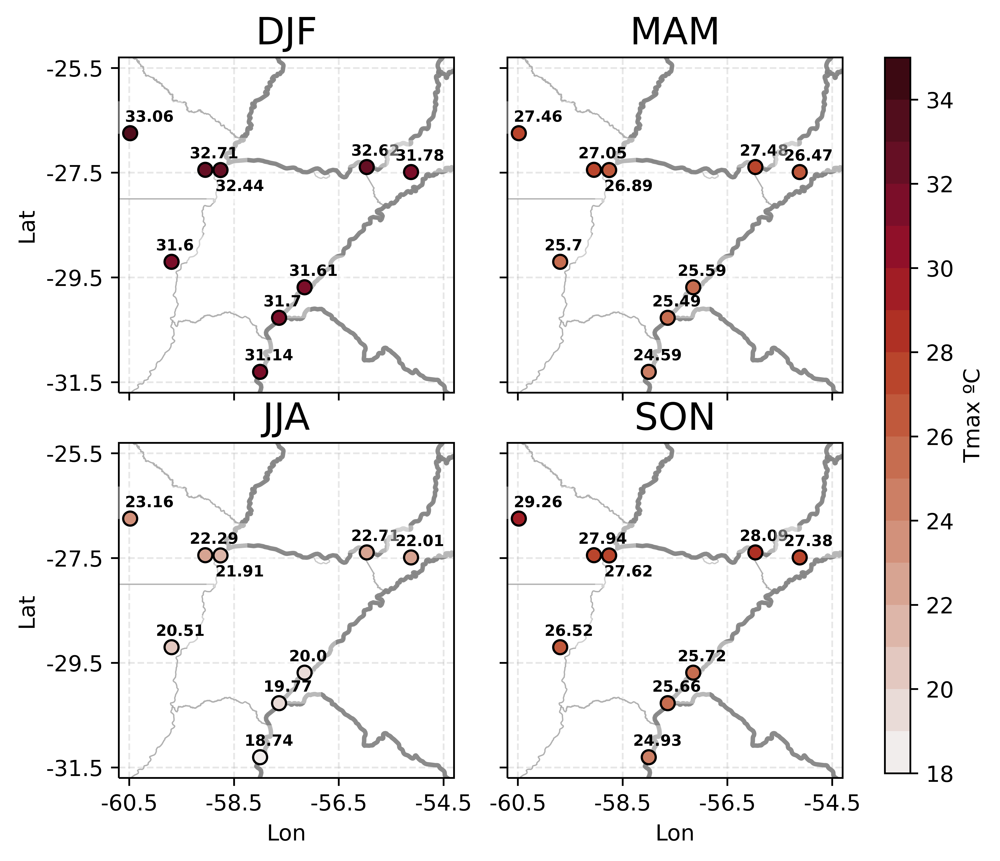

In [25]:
#Grafico medias estacionales

estaciones = ["DJF", "MAM", "JJA", "SON"]
posicion = [221, 222, 223, 224]
medias_DJF_estaciones_ordenadas = [climatologia_estacion_medias_mensuales_smn[i]["DJF"].values[0] for i in ides_omm_ordenado]
medias_MAM_estaciones_ordenadas = [climatologia_estacion_medias_mensuales_smn[i]["MAM"].values[0] for i in ides_omm_ordenado]
medias_JJA_estaciones_ordenadas = [climatologia_estacion_medias_mensuales_smn[i]["JJA"].values[0] for i in ides_omm_ordenado]
medias_SON_estaciones_ordenadas = [climatologia_estacion_medias_mensuales_smn[i]["SON"].values[0] for i in ides_omm_ordenado]
medias_estaciones_ordenadas_list = [medias_DJF_estaciones_ordenadas,medias_MAM_estaciones_ordenadas,medias_JJA_estaciones_ordenadas,medias_SON_estaciones_ordenadas]

def plot_mapa_medias_estacionales():
    valor_minimo = 18
    valor_maximo = 35
    xticks_min = -60.5
    xticks_max = -54.5
    yticks_min = -31.5
    yticks_max = -25.5
    espacio_entre_lat_lon = 1
    fig3b = plt.figure(figsize = [8, 6], dpi = 900) 

    for i in range(0,4):
        ax = fig3b.add_subplot(posicion[i], projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

        #agrego geometrias de fondo: provincias y paises
        ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 1)
        ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 2)

        #defino puntos a marcar
        geometry_3 = [Point(xy) for xy in lista_puntos_smn_ordenados] #lista con puntos 2
        geodata3 = gpd.GeoDataFrame(lista_puntos_smn_ordenados, geometry = geometry_3)
        geodata3["valores"] = medias_estaciones_ordenadas_list[i]

        mi_cmap = cmocean.cm.amp # define the colormap  rain
        mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)] # extract all colors from the .rain map
        mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
            'Custom cmap', mi_cmaplist, mi_cmap.N) # create the new map
        bounds = np.linspace(valor_minimo, valor_maximo, 18) # define the bins and normalize
        norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)
        ##fin de discretizado de paleta

        geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                      markersize = 40, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, edgecolor = "k") #limites de 0 a 8

        #agrego etiquetas con valores
        list_smn_etiquetas = [(lon-0.3-360, lat+0.30) for lon, lat in lista_puntos_smn_ordenados]
        for j, clave in enumerate(medias_estaciones_ordenadas_list[i]):
            if list(estaciones_ordenadas.values())[j] != "Resistencia" and list(estaciones_ordenadas.values())[j] != "Corrientes" and list(estaciones_ordenadas.values())[j] != "Roque Saenz Peña":
                t = ax.annotate(str(round(clave,2)), (list_smn_etiquetas[j][0],list_smn_etiquetas[j][1]-0.08), size = 7,weight='bold', zorder = 3)
            elif list(estaciones_ordenadas.values())[j] == "Corrientes":
                t = ax.annotate(str(round(clave,2)), (list_smn_etiquetas[j][0]+0.2,list_smn_etiquetas[j][1]-0.7), size = 7,weight='bold', zorder = 3)
            elif list(estaciones_ordenadas.values())[j] == "Roque Saenz Peña":
                t = ax.annotate(str(round(clave,2)), (list_smn_etiquetas[j][0]+0.2,list_smn_etiquetas[j][1]-0.08), size = 7,weight='bold', zorder = 3)
            else:
                t = ax.annotate(str(round(clave,2)), (list_smn_etiquetas[j][0],list_smn_etiquetas[j][1]-0.08) , size = 7,weight='bold', zorder = 3)
            t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))

        #agrego titulo a colorbar
        #trans = ax.get_xaxis_transform() # x in data untis, y in axes fraction
        #ann = ax.annotate('Okta', xy=(-52.7, .5 ), xycoords=trans, rotation = 90)

        #seteo ejes
        #x
        ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
        plt.xticks(np.arange(xticks_min, xticks_max+1, 2))
        if i == 0 or i == 1: #saco levels de x para los dos graficos de arriba
            ax.set_xticklabels([])
        else:
            ax.set_xticklabels(np.arange(xticks_min, xticks_max+1, 2))
            ax.set_xlabel("Lon")
        #y 
        ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
        plt.yticks(np.arange(yticks_min, yticks_max+1, 2))
        if i == 1 or i == 3: #saco levels de x para los dos graficos de la derecha
            ax.set_yticklabels([])
        else:
            ax.set_yticklabels(np.arange(yticks_min, yticks_max+1, 2))
            ax.set_ylabel("Lat")
        ax.grid(linestyle="--", alpha=0.3)
        ax.set_title(estaciones[i], size= 17)

    #fig3b.subplots_adjust(right=0.8)
    fig3b.subplots_adjust(wspace=-0.35,hspace=0.15)
    cbar_ax = fig3b.add_axes([0.83, 0.13, 0.02, 0.75])

    sm = plt.cm.ScalarMappable(cmap=mi_cmap2, norm=norm)
    # fake up the array of the scalar mappable. Urgh...
    sm._A = []
    fig3b.colorbar(sm, cax=cbar_ax,label = "Tmax ºC")

plot_mapa_medias_estacionales()

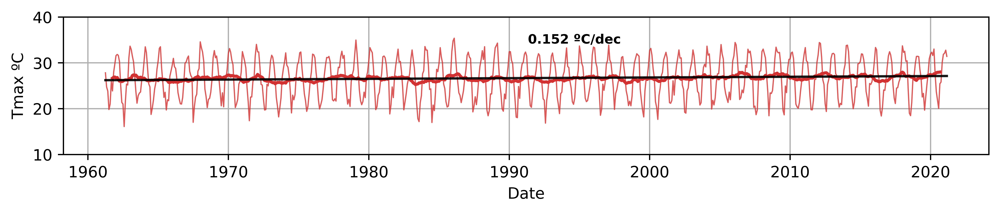

In [31]:
############# 4. SERIE TEMPORAL CON TENDENCIA ###############
#defino funcion que calcula tendencia_theil_sen
import pymannkendall as mk
import scipy

def tendencia_theil_sen(serie):
    valores = serie.values[np.isfinite(serie.values)]
    #fechas = np.arange(0, len(serie), 1)[np.isfinite(serie.values)]
    fechas = np.arange(0, len(valores), 1)
        
    # si el vector es todo de nan entonces que no calcule la tendencia, y que devuelva nan
    if valores.size <= 1:
        tendencia = np.nan
        significativo = np.nan
        
    # si el vector tiene valores distintos de nan calcula tendencia y significancia con 95%
    elif valores.size > 1:
        coef = scipy.stats.mstats.theilslopes(y=valores, x=fechas, alpha=0.95)
        tendencia = coef[0]  # dada entre un intervalo de tiempo. A esta salida si quiero tendencia decadal e ingrese datos de toda la serie mensual lo multiplico por 10*12 y si quiero por decada y vienen dados por un dato anual se multiplica por 10
        coord_origen = coef[1]
        
        ##Hago el test con el z estadistico para alpha = 0.95
        #z_test = mk.original_test(valores, alpha = 0.05)[3]
        #if abs(z_test) >= 1.96:
         #   significativo_95 = True
        #elif abs(z_test) < 1.96:
         #   significativo_95 = False
        
        ##Hago el test con el p-value para y determino si es significativo con alpha = 0.95 o alpha=0.90
        pvalue_test = mk.original_test(valores)[2]
        if pvalue_test <= 0.01:
            significativo_99 = True
            significativo_95 = True
            significativo_90 = True
        elif pvalue_test <= 0.05:
            significativo_99 = False
            significativo_95 = True
            significativo_90 = True
        elif pvalue_test <= 0.1:
            significativo_99 = False
            significativo_95 = False
            significativo_90 = True
        else:
            significativo_99 = False
            significativo_95 = False
            significativo_90 = False        
    return(coord_origen, tendencia, significativo_99, significativo_95, significativo_90, pvalue_test)

#grafico serie con media movil
#calculo media mobil de 12 meses
from f_promedio_movil import f_promedio_movil

def plot_serie_tendencia_media_movil(fecha_inicio, fecha_final):
    #data
    medias_mensuales_smn_media_regional_data = medias_mensuales_smn_media_regional.loc[fecha_inicio:fecha_final]
    ventana = 12
    medias_mensuales_smn_media_regional_media_movil_data = f_promedio_movil(medias_mensuales_smn_media_regional_data, ventana)
    
    fig4b = plt.figure(num=1, figsize=(9, 2), dpi=900)
    
    plt.subplot(1, 1, 1)
    plt.plot(medias_mensuales_smn_media_regional_data, color = "#D23232", linewidth = 0.8, alpha = 0.8)
    plt.plot(medias_mensuales_smn_media_regional_data.index, medias_mensuales_smn_media_regional_media_movil_data, color = "#D23232", linewidth = 2, alpha = 1)

    plt.ylim((10,40))
    plt.ylabel("Tmax ºC")
    plt.xlabel("Date")  
    plt.axhline(y=0, color='grey', linestyle='-')
    plt.grid()
    plt.tight_layout()
    #tendencia theil sen
    tendencia_smn_sen = tendencia_theil_sen(medias_mensuales_smn_media_regional_data)
    pendiente_smn_sen = tendencia_smn_sen[1]
    origen_smn_sen = tendencia_smn_sen[0]
    significativo_smn_sen_99 = tendencia_smn_sen[2]
    significativo_smn_sen_95 = tendencia_smn_sen[3]
    significativo_smn_sen_90 = tendencia_smn_sen[4]
    grafico_tendencia_smn_sen = origen_smn_sen + pendiente_smn_sen * np.arange(0, len(medias_mensuales_smn_media_regional_data.index), 1)
    if significativo_smn_sen_99 == True:
        plt.text(9000, 35, f"{round(pendiente_smn_sen*10*12, 3)} ºC/dec ***",color="k", 
                         ha="center", va = "center", fontsize =  'small',
                         weight='bold') #horizontalalignment='center', verticalalignment='center'
    elif significativo_smn_sen_99 == False and significativo_smn_sen_95 == True:
        plt.text(9000, 35, f"{round(pendiente_smn_sen*10*12, 3)} ºC/dec **",color="k", 
                         ha="center", va = "center", fontsize =  'small',
                         weight='bold') #horizontalalignment='center', verticalalignment='center'
    elif significativo_smn_sen_99 == False and significativo_smn_sen_95 == False and significativo_smn_sen_90 == True:
        plt.text(9000, 35, f"{round(pendiente_smn_sen*10*12, 3)} ºC/dec *",color="k", 
                         ha="center", va = "center", fontsize =  'small',
                         weight='bold') #horizontalalignment='center', verticalalignment='center'
    else:
        plt.text(9000, 35, f"{round(pendiente_smn_sen*10*12, 3)} ºC/dec",color="k", 
                         ha="center", va = "center", fontsize =  'small',
                         weight='bold') #horizontalalignment='center', verticalalignment='center'
    plt.plot(medias_mensuales_smn_media_regional_data.index, 
                 grafico_tendencia_smn_sen,color = "k", alpha = 0.9)
    #return(fig4b)

#intervalo temporal 1
fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"
#plot_serie_tendencia_media_movil(fecha_inicio_climatologia_str, fecha_final_climatologia_str)
plt.close()

#intervalo temporal 2 March 1961 to February 2021
fecha_inicio_str = "1961-03-01"
fecha_final_str = "2021-02-28"
plot_serie_tendencia_media_movil(fecha_inicio_str, fecha_final_str)


In [32]:
############### 5. CALCULO DE TENDENCIAS DE THEIL-SEN POR ESTACION PARA LA MEDIA REGIONAL #############

#calculo serie de medias estacionales de la media regional
#smn
#absoluto
#hago medias estacionales y luego hago la media regional de esas series
def calculo_medias_estaciones_smn(serie, estacion = "DJF"):
    serie_fechas = pd.to_datetime(serie.index)
    medias_estacion_list =  [] #donde se van acomodando los datos
    for anio in serie_fechas.year.unique():#iterar sobre los anios
        data_anio = serie[serie.index.year == anio]
        #data_anio = xrdata.sel[dict(time = xrdata.time[serie_fechas.year == anio])]
        if estacion == "DJF":
            try:
                data_anio_previo = serie[serie.index.year == anio-1]
                Dec = data_anio_previo[data_anio_previo.index.month == 12]
                Jan = data_anio[data_anio.index.month == 1]
                Feb = data_anio[data_anio.index.month == 2]
                data_estacion = pd.concat([Dec, Jan, Feb])             
                data_media_estacion = data_estacion.mean(axis=0, skipna=True)
                #data_media_estacion.attrs['time'] = anio
                medias_estacion_list.append(data_media_estacion)
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan
        elif estacion == "MAM":
            try:
                Mar = data_anio[data_anio.index.month ==  3]
                Abr = data_anio[data_anio.index.month ==  4]
                May = data_anio[data_anio.index.month ==  5]
                data_estacion = pd.concat([Mar,Abr,May])                
                data_media_estacion = data_estacion.mean(axis=0, skipna=True)
                #data_media_estacion.attrs['time'] = anio
                medias_estacion_list.append(data_media_estacion)
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan          
        elif estacion == "JJA":
            try:
                Jun = data_anio[data_anio.index.month == 6]
                Jul = data_anio[data_anio.index.month == 7]
                Ag = data_anio[data_anio.index.month == 8]
                data_estacion = pd.concat([Jun, Jul, Ag])                  
                data_media_estacion = data_estacion.mean(axis=0, skipna=True)
                #data_media_estacion.attrs['time'] = anio
                medias_estacion_list.append(data_media_estacion)        
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan   
        elif estacion == "SON":
            try:
                Sep = data_anio[data_anio.index.month == 9]
                Oct = data_anio[data_anio.index.month == 10]
                Nov = data_anio[data_anio.index.month == 11]
                data_estacion = pd.concat([Sep,Oct,Nov])                  
                data_media_estacion = data_estacion.mean(axis=0, skipna=True)
                #data_media_estacion.attrs['time'] = anio
                medias_estacion_list.append(data_media_estacion)
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan        
    #xr_medias_estacion = xr.concat(xr_medias_estacion_list, dim = "time")
    medias_estacion_df = pd.DataFrame(medias_estacion_list)
    medias_estacion_df.index = serie_fechas.year.unique()
    return medias_estacion_df
#medias_mensuales_smn_media_regional[medias_mensuales_smn_media_regional.index.month==12]

################ periodo 1983-2016 ################
fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"

#media estacional
series_medias_estacionales_DJF_estaciones_ordenadas = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_climatologia_str: fecha_final_climatologia_str], estacion = "DJF") for i in ides_omm_ordenado]
series_medias_estacionales_MAM_estaciones_ordenadas = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_climatologia_str: fecha_final_climatologia_str], estacion = "MAM") for i in ides_omm_ordenado]
series_medias_estacionales_JJA_estaciones_ordenadas = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_climatologia_str: fecha_final_climatologia_str], estacion = "JJA") for i in ides_omm_ordenado]
series_medias_estacionales_SON_estaciones_ordenadas = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_climatologia_str: fecha_final_climatologia_str], estacion = "SON") for i in ides_omm_ordenado]
series_medias_estacionales_estaciones_ordenadas_list = [series_medias_estacionales_DJF_estaciones_ordenadas,
                                                        series_medias_estacionales_MAM_estaciones_ordenadas,
                                                        series_medias_estacionales_JJA_estaciones_ordenadas,
                                                        series_medias_estacionales_SON_estaciones_ordenadas]
#media regional
smn_series_medias_estacionales_media_regional_DJF = pd.concat(series_medias_estacionales_estaciones_ordenadas_list[0], axis = 1).mean(axis = 1, skipna = True)
smn_series_medias_estacionales_media_regional_MAM = pd.concat(series_medias_estacionales_estaciones_ordenadas_list[1], axis = 1).mean(axis = 1, skipna = True)
smn_series_medias_estacionales_media_regional_JJA = pd.concat(series_medias_estacionales_estaciones_ordenadas_list[2], axis = 1).mean(axis = 1, skipna = True)
smn_series_medias_estacionales_media_regional_SON = pd.concat(series_medias_estacionales_estaciones_ordenadas_list[3], axis = 1).mean(axis = 1, skipna = True)

#calculo la tendencia de theil-sen
smn_series_medias_estacionales_media_regional_DJF_tendencia_1983_2016 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_DJF)
smn_series_medias_estacionales_media_regional_MAM_tendencia_1983_2016 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_MAM)
smn_series_medias_estacionales_media_regional_JJA_tendencia_1983_2016 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_JJA)
smn_series_medias_estacionales_media_regional_SON_tendencia_1983_2016 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_SON)

tabla_tendencias_1983_2016 =  pd.DataFrame({"DJF": [smn_series_medias_estacionales_media_regional_DJF_tendencia_1983_2016[1],smn_series_medias_estacionales_media_regional_DJF_tendencia_1983_2016[5]],
                                              "MAM": [smn_series_medias_estacionales_media_regional_MAM_tendencia_1983_2016[1],smn_series_medias_estacionales_media_regional_MAM_tendencia_1983_2016[5]],
                                              "JJA": [smn_series_medias_estacionales_media_regional_JJA_tendencia_1983_2016[1],smn_series_medias_estacionales_media_regional_JJA_tendencia_1983_2016[5]],
                                              "SON": [smn_series_medias_estacionales_media_regional_SON_tendencia_1983_2016[1],smn_series_medias_estacionales_media_regional_SON_tendencia_1983_2016[5]]}).transpose()
tabla_tendencias_1983_2016.columns = ["1983_2016_tendencia","1983_2016_p_valor"]
tabla_tendencias_1983_2016["1983_2016_tendencia"] = tabla_tendencias_1983_2016["1983_2016_tendencia"]*10
tabla_tendencias_1983_2016.columns = ["1983_2016_tendencia ºC/dec","1983_2016_p_valor"]

#hago lo mismo que antes pero para el periodo 1961-2020
#uso datos de marzo 1961 a febrero 2021 para tener estaciones completas 

fecha_inicio_str = "1961-03-01"
fecha_final_str = "2021-02-28"

series_medias_estacionales_DJF_estaciones_ordenadas_2 = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_str: fecha_final_str], estacion = "DJF") for i in ides_omm_ordenado]
series_medias_estacionales_MAM_estaciones_ordenadas_2 = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_str: fecha_final_str], estacion = "MAM") for i in ides_omm_ordenado]
series_medias_estacionales_JJA_estaciones_ordenadas_2 = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_str: fecha_final_str], estacion = "JJA") for i in ides_omm_ordenado]
series_medias_estacionales_SON_estaciones_ordenadas_2 = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_str: fecha_final_str], estacion = "SON") for i in ides_omm_ordenado]
series_medias_estacionales_estaciones_ordenadas_list_2 = [series_medias_estacionales_DJF_estaciones_ordenadas_2,
                                                        series_medias_estacionales_MAM_estaciones_ordenadas_2,
                                                        series_medias_estacionales_JJA_estaciones_ordenadas_2,
                                                        series_medias_estacionales_SON_estaciones_ordenadas_2]

smn_series_medias_estacionales_media_regional_DJF_2 = pd.concat(series_medias_estacionales_estaciones_ordenadas_list_2[0], axis = 1).mean(axis = 1, skipna = True)
smn_series_medias_estacionales_media_regional_MAM_2 = pd.concat(series_medias_estacionales_estaciones_ordenadas_list_2[1], axis = 1).mean(axis = 1, skipna = True)
smn_series_medias_estacionales_media_regional_JJA_2 = pd.concat(series_medias_estacionales_estaciones_ordenadas_list_2[2], axis = 1).mean(axis = 1, skipna = True)
smn_series_medias_estacionales_media_regional_SON_2 = pd.concat(series_medias_estacionales_estaciones_ordenadas_list_2[3], axis = 1).mean(axis = 1, skipna = True)

#calculo la tendencia de theil-sen
smn_series_medias_estacionales_media_regional_DJF_tendencia_1961_2021 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_DJF_2)
smn_series_medias_estacionales_media_regional_MAM_tendencia_1961_2021 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_MAM_2)
smn_series_medias_estacionales_media_regional_JJA_tendencia_1961_2021 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_JJA_2)
smn_series_medias_estacionales_media_regional_SON_tendencia_1961_2021 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_SON_2)

tabla_tendencias_1961_2021 =  pd.DataFrame({"DJF": [smn_series_medias_estacionales_media_regional_DJF_tendencia_1961_2021[1],smn_series_medias_estacionales_media_regional_DJF_tendencia_1961_2021[5]],
                                              "MAM": [smn_series_medias_estacionales_media_regional_MAM_tendencia_1961_2021[1],smn_series_medias_estacionales_media_regional_MAM_tendencia_1961_2021[5]],
                                              "JJA": [smn_series_medias_estacionales_media_regional_JJA_tendencia_1961_2021[1],smn_series_medias_estacionales_media_regional_JJA_tendencia_1961_2021[5]],
                                              "SON": [smn_series_medias_estacionales_media_regional_SON_tendencia_1961_2021[1],smn_series_medias_estacionales_media_regional_SON_tendencia_1961_2021[5]]}).transpose()
tabla_tendencias_1961_2021.columns = ["1961_2021_tendencia","1961_2021_p_valor"]
tabla_tendencias_1961_2021["1961_2021_tendencia"] = tabla_tendencias_1961_2021["1961_2021_tendencia"]*10
tabla_tendencias_1961_2021.columns = ["1961_2021_tendencia ºC/dec","1961_2021_p_valor"]

tabla_tendencias = pd.concat([tabla_tendencias_1983_2016, tabla_tendencias_1961_2021], axis = 1)
tabla_tendencias

,1983_2016_tendencia ºC/dec,1983_2016_p_valor,1961_2021_tendencia ºC/dec,1961_2021_p_valor
DJF,0.144651,0.271287,0.081814,0.124274
MAM,0.127974,0.360627,0.044148,0.494962
JJA,0.237056,0.209462,0.117056,0.191051
SON,0.310961,0.039326,0.214132,0.000463


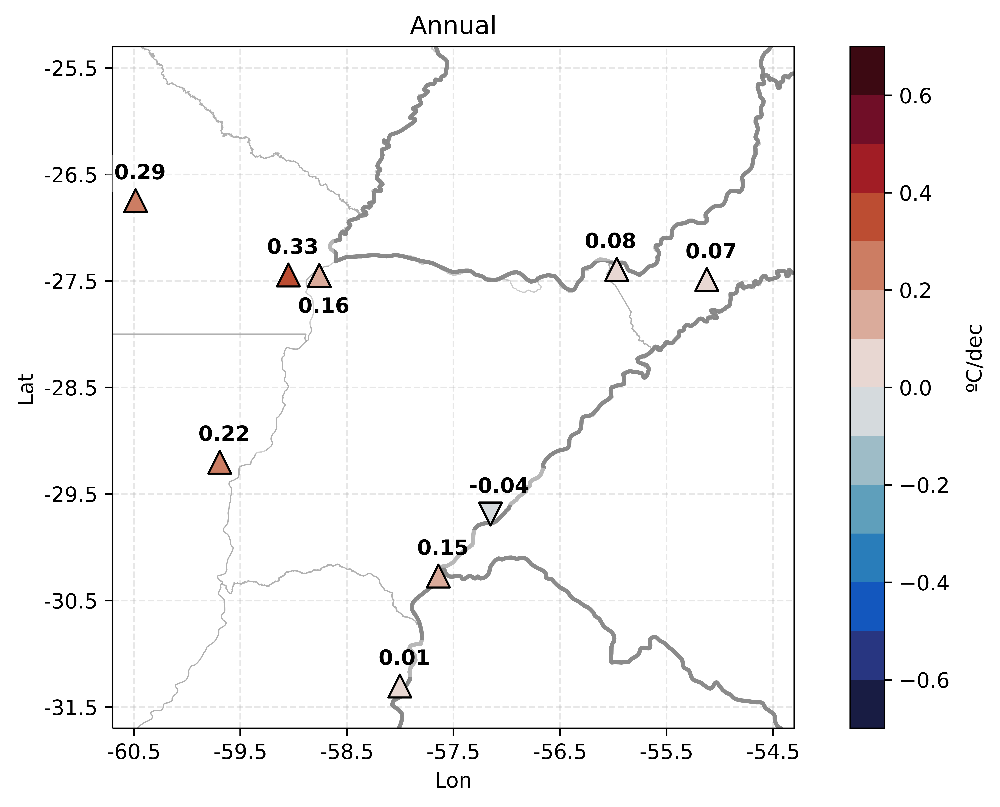

In [42]:
############ 6. MAPA CON TENDENCIAS ANUAL PERIODO CLIMATOLOGICO ##############
from f_mis_shapes import df_paises, df_provincias
import geopandas as gpd
from shapely.geometry import Point
import cartopy.crs as ccrs
import cmocean 
import matplotlib as mpl

fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"

# Calculo tendencia anual de heliofania en periodo climatológico de SMN
tendencia_anual_smn = {} 
for id_omm in ides_omm_ordenado: #para cada id_omm_ordenado
    #calculo climatologia 
    mensual_df = medias_mensuales_smn[id_omm]
    mensual_df.index = pd.to_datetime(medias_mensuales_smn[id_omm].index)
    mensual_fechas_climatologia = mensual_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    mensual_tendencia_anual_theil_sen = tendencia_theil_sen(mensual_fechas_climatologia)
    tendencia_anual_smn[id_omm] = mensual_tendencia_anual_theil_sen #Lo guardo en diccionario: climatologia_anual_medias_mensuales_smn

#puntos que uso
lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,9)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)

#hago lista con valores de tendencia
tendencias_anuales_estaciones_ordenadas = [tendencia_anual_smn[i][1]*10*12 for i in estaciones_ordenadas.keys()]
#distingo entre mayor a cero, menor e igual a cero porque van a tener distinto simbolo
lista_puntos_smn_mayor_a_cero = []
lista_puntos_smn_menor_a_cero = []
lista_puntos_smn_igual_a_cero = []
for i in range(len(lista_puntos_smn_ordenados)):
    if tendencias_anuales_estaciones_ordenadas[i] < 0:  #tendencias_anuales_estaciones_ordenadas[i] < 0
        lista_puntos_smn_menor_a_cero.append(lista_puntos_smn_ordenados[i])
    elif tendencias_anuales_estaciones_ordenadas[i] > 0:
        lista_puntos_smn_mayor_a_cero.append(lista_puntos_smn_ordenados[i])
    else:
        lista_puntos_smn_igual_a_cero.append(lista_puntos_smn_ordenados[i])
valores_menor_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor<0]
valores_mayor_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor>0]
valores_igual_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor==0]

#hago lista con simbolos de significancia
tendencias_anuales_estaciones_ordenadas = [tendencia_anual_smn[i][1]*10*12 for i in estaciones_ordenadas.keys()]
lista_significancia = []
for est in estaciones_ordenadas.keys():
    if tendencia_anual_smn[est][2] == True:
        lista_significancia.append("***")
    elif tendencia_anual_smn[est][2] == False and tendencia_anual_smn[est][3] == True:
        lista_significancia.append("**")
    elif tendencia_anual_smn[est][2] == False and tendencia_anual_smn[est][3] == False and tendencia_anual_smn[est][4] == True:
        lista_significancia.append("*")
    else:
        lista_significancia.append(" ")

#grafico
def plot_mapa_tendencias():
    valor_minimo = -0.7
    valor_maximo = 0.7
    xticks_min = -60.5
    xticks_max = -54.5
    yticks_min = -31.5
    yticks_max = -25.5
    espacio_entre_lat_lon = 1
    tendencias_anuales_estaciones_ordenadas = [tendencia_anual_smn[i][1]*10*12 for i in ides_omm_ordenado]

    #defino puntos a marcar (distingo entre tendencias positivas, negativas o nulas)
    geometry_1 = [Point(xy) for xy in lista_puntos_smn_igual_a_cero] #lista con puntos 2
    geodata1 = gpd.GeoDataFrame(lista_puntos_smn_igual_a_cero, geometry = geometry_1)
    geodata1["valores"] = valores_igual_a_cero

    geometry_2 = [Point(xy) for xy in lista_puntos_smn_mayor_a_cero] #lista con puntos 2
    geodata2 = gpd.GeoDataFrame(lista_puntos_smn_mayor_a_cero, geometry = geometry_2)
    geodata2["valores"] = valores_mayor_a_cero

    geometry_3 = [Point(xy) for xy in lista_puntos_smn_menor_a_cero] #lista con puntos 2
    geodata3 = gpd.GeoDataFrame(lista_puntos_smn_menor_a_cero, geometry = geometry_3)
    geodata3["valores"] = valores_menor_a_cero

    fig1 = plt.figure(figsize =  [9.6, 6], dpi = 1000)    #dpi = 600
    ax = fig1.add_subplot(111, projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

    #agrego geometrias de fondo: provincias y paises
    ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 1)
    ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 2)

    ###esto para discretizar la paleta:
    ##
    mi_cmap = cmocean.cm.balance # define the colormap  diff al reves
    ## extract all colors from the .rain map
    mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)]
    ## create the new map
    mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
        'Custom cmap', mi_cmaplist, mi_cmap.N)
    ## define the bins and normalize
    bounds = np.linspace(valor_minimo, valor_maximo, 15)
    norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)
    ##fin de discretizado de paleta

    #grafico puntos
    geodata1.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                  markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                  edgecolor = "k", marker='o') #limites de 0 a 8

    geodata2.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                  markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                  edgecolor = "k", marker='^') #limites de 0 a 8

    geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                  markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=True, ax = ax, 
                  edgecolor = "k", marker = "v") #limites de 0 a 8

    #agrego etiquetas con valores
    list_smn_etiquetas = [(lon-0.2-360, lat+0.25) for lon, lat in lista_puntos_smn_ordenados]
    for i, clave in enumerate(tendencias_anuales_estaciones_ordenadas):
        if list(estaciones_ordenadas.values())[i] != "Posadas" and list(estaciones_ordenadas.values())[i] != "Corrientes" and list(estaciones_ordenadas.values())[i] != "Resistencia":
            if round(clave,2) == 0:
                t = ax.annotate(f"{0}{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
            else:
                t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)

        elif list(estaciones_ordenadas.values())[i] == "Corrientes":
            if round(clave,2) == 0:
                t = ax.annotate(f"{round(0)}{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.6) , size = 10,weight='bold', zorder = 3)
            else:
                t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.6) , size = 10,weight='bold', zorder = 3)

        elif list(estaciones_ordenadas.values())[i] == "Posadas":
            if round(clave,2) == 0:
                t = ax.annotate(f"{0}{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
            else:
                t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0]-0.1,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)

        else:
            if round(clave,2) == 0:
                t = ax.annotate(f"{0}{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.05) , size = 10,weight='bold', zorder = 3)
            else:
                t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05) , size = 10,weight='bold', zorder = 3)

        t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))

    ##agrego titulo a colorbar
    trans = ax.get_xaxis_transform() # x in data untis, y in axes fraction
    ann = ax.annotate('ºC/dec', xy=(-52.7, .5 ), xycoords=trans, rotation = 90)

    #seteo ejes
    ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
    ax.set_xticklabels(np.arange(xticks_min, xticks_max+1))
    plt.xticks(np.arange(xticks_min, xticks_max+1))
    ax.set_xlabel("Lon")
    ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
    ax.set_yticklabels(np.arange(yticks_min, yticks_max+1))
    plt.yticks(np.arange(yticks_min, yticks_max+1))
    ax.set_ylabel("Lat")
    plt.title("Annual")

    plt.grid(linestyle="--", alpha=0.3)

plot_mapa_tendencias() #periodo clim

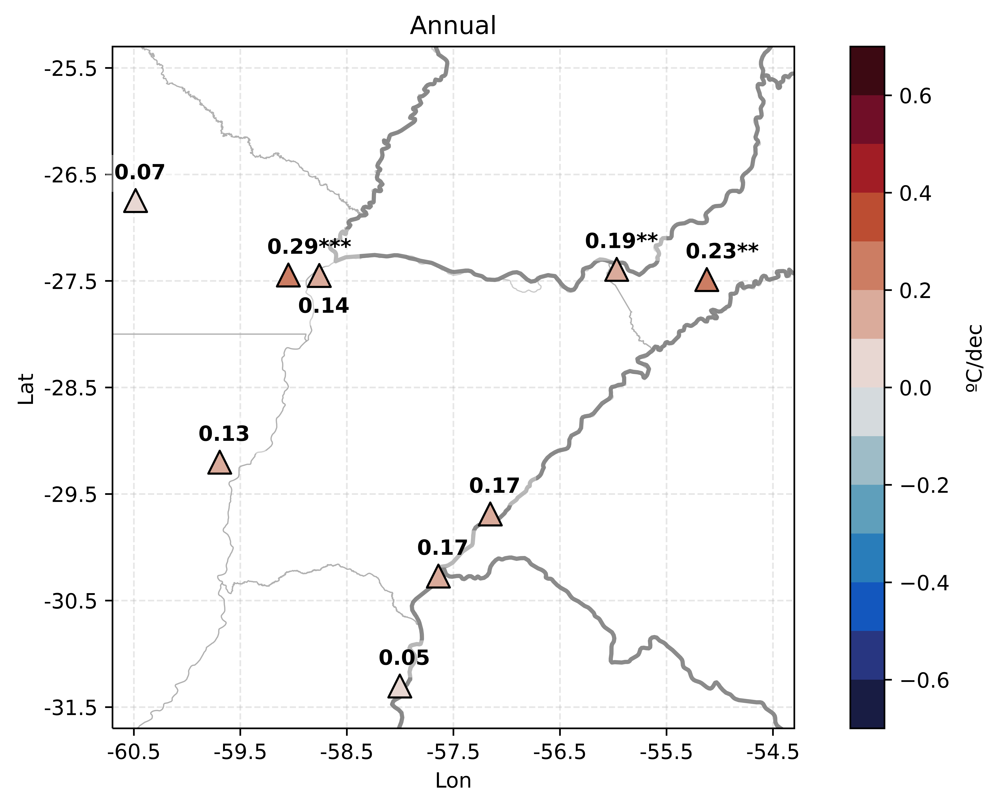

In [39]:
############ 6. MAPA CON TENDENCIAS ANUAL PERIODO A LARGO PLAZO ##############
from f_mis_shapes import df_paises, df_provincias
import geopandas as gpd
from shapely.geometry import Point
import cartopy.crs as ccrs
import cmocean 
import matplotlib as mpl

fecha_inicio_str = "1961-03-01"
fecha_final_str = "2021-02-28"

# Calculo tendencia anual de heliofania en periodo climatológico de SMN
tendencia_anual_smn = {} 
for id_omm in ides_omm_ordenado: #para cada id_omm_ordenado
    #calculo climatologia 
    mensual_df = medias_mensuales_smn[id_omm]
    mensual_df.index = pd.to_datetime(medias_mensuales_smn[id_omm].index)
    mensual_fechas_climatologia = mensual_df.loc[fecha_inicio_str:fecha_final_str]
    mensual_tendencia_anual_theil_sen = tendencia_theil_sen(mensual_fechas_climatologia)
    tendencia_anual_smn[id_omm] = mensual_tendencia_anual_theil_sen #Lo guardo en diccionario: climatologia_anual_medias_mensuales_smn

#puntos que uso
lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,9)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)

#hago lista con valores de tendencia
tendencias_anuales_estaciones_ordenadas = [tendencia_anual_smn[i][1]*10*12 for i in estaciones_ordenadas.keys()]
#distingo entre mayor a cero, menor e igual a cero porque van a tener distinto simbolo
lista_puntos_smn_mayor_a_cero = []
lista_puntos_smn_menor_a_cero = []
lista_puntos_smn_igual_a_cero = []
for i in range(len(lista_puntos_smn_ordenados)):
    if tendencias_anuales_estaciones_ordenadas[i] < 0:  #tendencias_anuales_estaciones_ordenadas[i] < 0
        lista_puntos_smn_menor_a_cero.append(lista_puntos_smn_ordenados[i])
    elif tendencias_anuales_estaciones_ordenadas[i] > 0:
        lista_puntos_smn_mayor_a_cero.append(lista_puntos_smn_ordenados[i])
    else:
        lista_puntos_smn_igual_a_cero.append(lista_puntos_smn_ordenados[i])
valores_menor_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor<0]
valores_mayor_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor>0]
valores_igual_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor==0]

#hago lista con simbolos de significancia
tendencias_anuales_estaciones_ordenadas = [tendencia_anual_smn[i][1]*10*12 for i in estaciones_ordenadas.keys()]
lista_significancia = []
for est in estaciones_ordenadas.keys():
    if tendencia_anual_smn[est][2] == True:
        lista_significancia.append("***")
    elif tendencia_anual_smn[est][2] == False and tendencia_anual_smn[est][3] == True:
        lista_significancia.append("**")
    elif tendencia_anual_smn[est][2] == False and tendencia_anual_smn[est][3] == False and tendencia_anual_smn[est][4] == True:
        lista_significancia.append("*")
    else:
        lista_significancia.append(" ")

plot_mapa_tendencias()

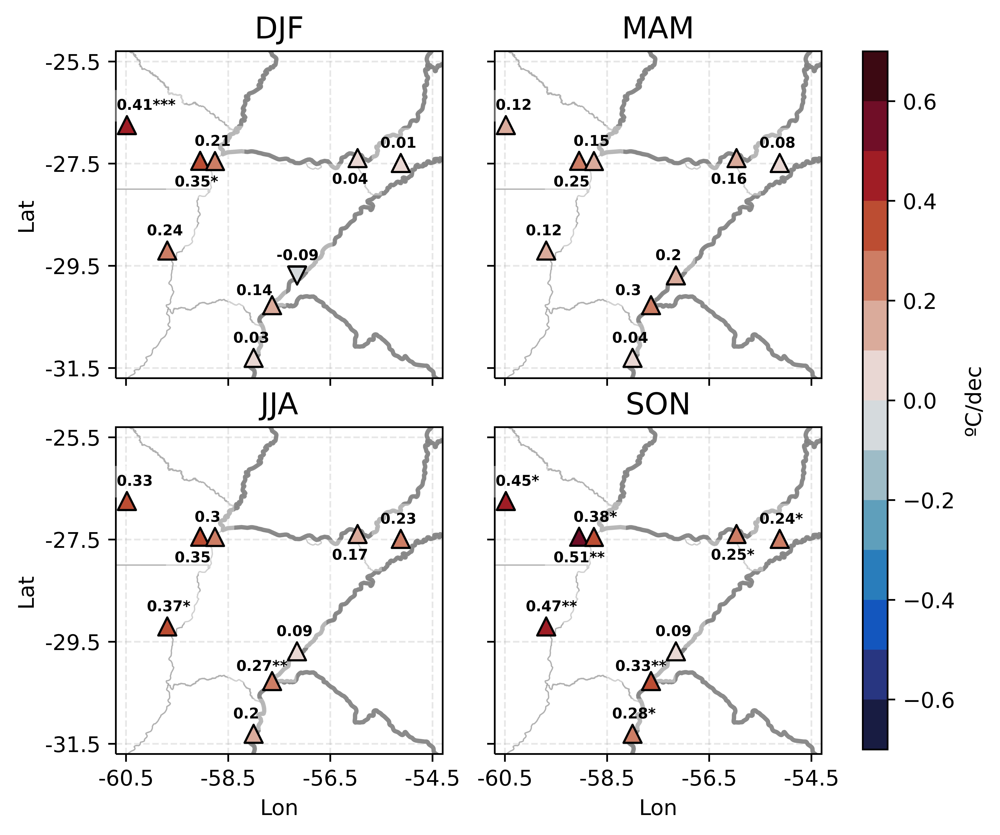

In [40]:
############ 6. MAPA CON TENDENCIAS ESTACIONALES PERIODO CLIMATOLOGICO ##############
fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"

estaciones = ["DJF", "MAM", "JJA", "SON"]
posicion = [221, 222, 223, 224]

lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,9)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)
lista_puntos_smn_ordenados
list(estaciones_ordenadas.values())[0]    

tendencias_DJF_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[0][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_MAM_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[1][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_JJA_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[2][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_SON_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[3][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_estaciones_ordenadas_list = [tendencias_DJF_estaciones_ordenadas,
                                           tendencias_MAM_estaciones_ordenadas,
                                           tendencias_JJA_estaciones_ordenadas,
                                           tendencias_SON_estaciones_ordenadas]

#significancias
tendencias_DJF_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[0][i]) for i in range(len(ides_omm_ordenado))]
tendencias_MAM_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[1][i]) for i in range(len(ides_omm_ordenado))]
tendencias_JJA_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[2][i]) for i in range(len(ides_omm_ordenado))]
tendencias_SON_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[3][i]) for i in range(len(ides_omm_ordenado))]
tendencias_estaciones_ordenadas_list_significancias = [tendencias_DJF_estaciones_ordenadas_significancias,
                                           tendencias_MAM_estaciones_ordenadas_significancias,
                                           tendencias_JJA_estaciones_ordenadas_significancias,
                                           tendencias_SON_estaciones_ordenadas_significancias]

def plot_mapa_tendencias_estaciones():
    valor_minimo = -0.7
    valor_maximo = 0.7
    xticks_min = -60.5
    xticks_max = -54.5
    yticks_min = -31.5
    yticks_max = -25.5
    espacio_entre_lat_lon = 1
    #fig1, ax = plt.subplots(2, 2, figsize=[9, 7], dpi=600)
    fig1 = plt.figure(figsize = [8, 6], dpi = 900) 

    for i in range(0,4):    
        ###########
        #distingo entre mayor a cero, menor e igual a cero porque van a tener distinto simbolo
        lista_puntos_smn_mayor_a_cero = []
        lista_puntos_smn_menor_a_cero = []
        lista_puntos_smn_igual_a_cero = []
        for j in range(len(lista_puntos_smn_ordenados)):
            if tendencias_estaciones_ordenadas_list[i][j] < 0:
                lista_puntos_smn_menor_a_cero.append(lista_puntos_smn_ordenados[j])
            elif tendencias_estaciones_ordenadas_list[i][j] > 0:
                lista_puntos_smn_mayor_a_cero.append(lista_puntos_smn_ordenados[j])
            elif tendencias_estaciones_ordenadas_list[i][j] == 0:
                lista_puntos_smn_igual_a_cero.append(lista_puntos_smn_ordenados[j])

        valores_menor_a_cero = [valor for valor in tendencias_estaciones_ordenadas_list[i] if valor<0]
        valores_mayor_a_cero = [valor for valor in tendencias_estaciones_ordenadas_list[i] if valor>0]
        valores_igual_a_cero = [valor for valor in tendencias_estaciones_ordenadas_list[i] if valor==0]

        #hago lista con simbolos de significancia
        lista_significancia = []
        for est in range(0, len(estaciones_ordenadas.keys())):
            if tendencias_estaciones_ordenadas_list_significancias[i][est][2] == True:
                lista_significancia.append("***")
            elif tendencias_estaciones_ordenadas_list_significancias[i][est][2] == False and tendencias_estaciones_ordenadas_list_significancias[i][est][3] == True:
                lista_significancia.append("**")
            elif tendencias_estaciones_ordenadas_list_significancias[i][est][2] == False and tendencias_estaciones_ordenadas_list_significancias[i][est][3] == False and tendencias_estaciones_ordenadas_list_significancias[i][est][4] == True:
                lista_significancia.append("*")
            else:
                lista_significancia.append(" ")
        ###########

        ax = fig1.add_subplot(posicion[i], projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

        #agrego geometrias de fondo: provincias y paises
        ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 1)
        ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 2)

        #defino puntos a marcar los distingo por tendencia positiva negativa o nula

        geometry_1 = [Point(xy) for xy in lista_puntos_smn_igual_a_cero] #lista con puntos 2
        geodata1 = gpd.GeoDataFrame(lista_puntos_smn_igual_a_cero, geometry = geometry_1)
        geodata1["valores"] = valores_igual_a_cero

        geometry_2 = [Point(xy) for xy in lista_puntos_smn_mayor_a_cero] #lista con puntos 2
        geodata2 = gpd.GeoDataFrame(lista_puntos_smn_mayor_a_cero, geometry = geometry_2)
        geodata2["valores"] = valores_mayor_a_cero

        geometry_3 = [Point(xy) for xy in lista_puntos_smn_menor_a_cero] #lista con puntos 2
        geodata3 = gpd.GeoDataFrame(lista_puntos_smn_menor_a_cero, geometry = geometry_3)
        geodata3["valores"] = valores_menor_a_cero

        mi_cmap = cmocean.cm.balance # define the colormap  rain
        # extract all colors from the .rain map
        mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)]
        # create the new map
        mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
            'Custom cmap', mi_cmaplist, mi_cmap.N)
        # define the bins and normalize
        bounds = np.linspace(valor_minimo, valor_maximo, 15)
        norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)
        ##fin de discretizado de paleta

        #grafico puntos
        #geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
        #              markersize = 200, cmap=cmocean.cm.rain, zorder=3,legend=True, ax = ax) #limites de 0 a 8

        geodata1.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                          markersize = 70, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                      edgecolor = "k", marker = "o") #limites de 0 a 8

        geodata2.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                          markersize = 70, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                      edgecolor = "k", marker = '^') #limites de 0 a 8

        geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                          markersize = 70, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                      edgecolor = "k", marker = "v") #limites de 0 a 8

        #agrego etiquetas con valores
        list_smn_etiquetas = [(lon-0.3-360, lat+0.30) for lon, lat in lista_puntos_smn_ordenados]
        for j, clave in enumerate(tendencias_estaciones_ordenadas_list[i]):
            if list(estaciones_ordenadas.values())[j] != "Montecaseros" and list(estaciones_ordenadas.values())[j] != "Resistencia" and list(estaciones_ordenadas.values())[j] != "Posadas" and list(estaciones_ordenadas.values())[j] != "Roque Saenz Peña":
                if round(clave,2) == 0:
                    t = ax.annotate(f"{0}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
                else:
                    t = ax.annotate(f"{round(clave,2)}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3) #-0.1
            
            elif list(estaciones_ordenadas.values())[j] == "Roque Saenz Peña":
                if round(clave,2)== 0:
                    t = ax.annotate(f"{0}{lista_significancia[j]}", (list_smn_etiquetas[j][0]+0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
                else:
                    t = ax.annotate(f"{round(clave,2)}{lista_significancia[j]}", (list_smn_etiquetas[j][0]+0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
            
            elif list(estaciones_ordenadas.values())[j] == "Montecaseros":
                if round(clave,2)== 0:
                    t = ax.annotate(f"{0}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.4,list_smn_etiquetas[j][1]-0.1) , size = 6.8,weight='bold', zorder = 3)
                else:
                    t = ax.annotate(f"{round(clave,2)}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.4,list_smn_etiquetas[j][1]-0.1) , size = 6.8,weight='bold', zorder = 3)
            
            else:
                if round(clave,2)== 0:
                    t = ax.annotate(f"{0}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.2,list_smn_etiquetas[j][1]-0.8) , size = 6.8,weight='bold', zorder = 3)
                else:
                    t = ax.annotate(f"{round(clave,2)}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.2,list_smn_etiquetas[j][1]-0.8) , size = 6.8,weight='bold', zorder = 3)
            t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))

        #agrego titulo a colorbar
        #trans = ax.get_xaxis_transform() # x in data untis, y in axes fraction
        #ann = ax.annotate('%/dec', xy=(-52.7, .5 ), xycoords=trans, rotation = 90)

        #seteo ejes
        ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
        plt.xticks(np.arange(xticks_min, xticks_max+1, 2))
        if i == 0 or i == 1: #saco levels de x para los dos graficos de arriba
            ax.set_xticklabels([])
        else:
            ax.set_xticklabels(np.arange(xticks_min, xticks_max+1, 2))
            ax.set_xlabel("Lon")


        ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
        plt.yticks(np.arange(yticks_min, yticks_max+1, 2))
        if i == 1 or i == 3: #saco levels de x para los dos graficos de la derecha
            ax.set_yticklabels([])
        else:
            ax.set_yticklabels(np.arange(yticks_min, yticks_max+1, 2))
            ax.set_ylabel("Lat")
        ax.grid(linestyle="--", alpha=0.3)
        ax.set_title(estaciones[i], size= 14)

    #fig1.subplots_adjust(right=0.8)
    fig1.subplots_adjust(wspace=-0.35,hspace=0.15)
    cbar_ax = fig1.add_axes([0.83, 0.13, 0.02, 0.75])

    sm = plt.cm.ScalarMappable(cmap=mi_cmap2, norm=norm)
    # fake up the array of the scalar mappable. Urgh...
    sm._A = []
    fig1.colorbar(sm, cax=cbar_ax,label = "ºC/dec")

plot_mapa_tendencias_estaciones()

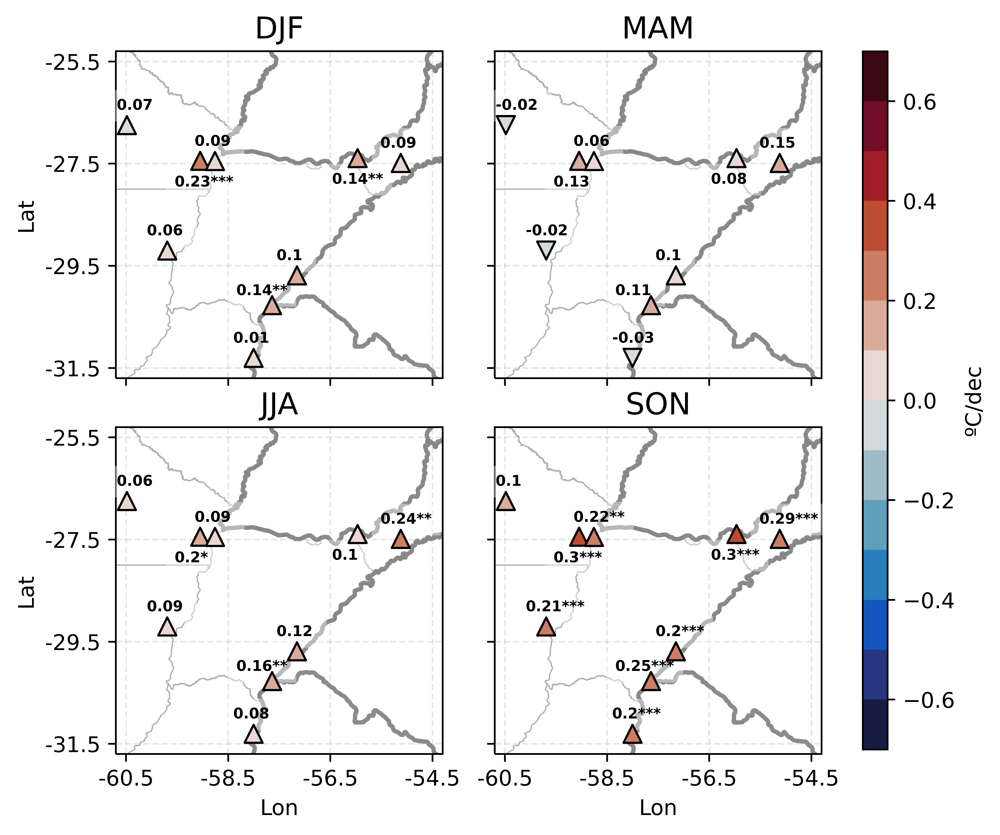

In [41]:
############ 6. MAPA CON TENDENCIAS ESTACIONALES A LARGO PLAZO ##############
fecha_inicio_str = "1961-03-01"
fecha_final_str = "2021-02-28"

estaciones = ["DJF", "MAM", "JJA", "SON"]
posicion = [221, 222, 223, 224]

lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,9)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)
lista_puntos_smn_ordenados
list(estaciones_ordenadas.values())[0]    

tendencias_DJF_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[0][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_MAM_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[1][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_JJA_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[2][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_SON_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[3][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_estaciones_ordenadas_list = [tendencias_DJF_estaciones_ordenadas,
                                           tendencias_MAM_estaciones_ordenadas,
                                           tendencias_JJA_estaciones_ordenadas,
                                           tendencias_SON_estaciones_ordenadas]

#significancias
tendencias_DJF_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[0][i]) for i in range(len(ides_omm_ordenado))]
tendencias_MAM_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[1][i]) for i in range(len(ides_omm_ordenado))]
tendencias_JJA_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[2][i]) for i in range(len(ides_omm_ordenado))]
tendencias_SON_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[3][i]) for i in range(len(ides_omm_ordenado))]
tendencias_estaciones_ordenadas_list_significancias = [tendencias_DJF_estaciones_ordenadas_significancias,
                                           tendencias_MAM_estaciones_ordenadas_significancias,
                                           tendencias_JJA_estaciones_ordenadas_significancias,
                                           tendencias_SON_estaciones_ordenadas_significancias]

plot_mapa_tendencias_estaciones()